# <CENTER> **PROJECT: Clustering Physical Activity Data**

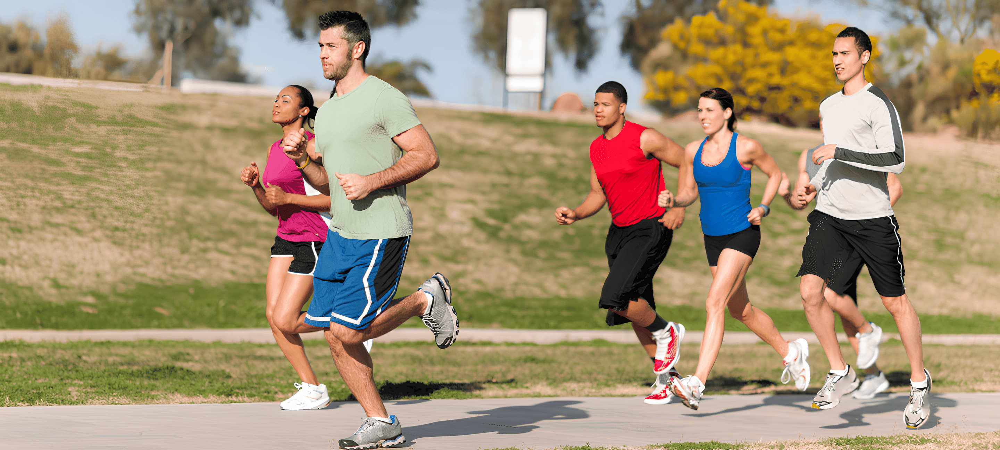

---

#### **Описание:**

В современном мире носимые устройства, такие как фитнес-браслеты, умные часы и различные сенсоры, играют ключевую роль в мониторинге физической активности человека. Эти данные используются в медицинских, спортивных и навигационных приложениях, помогая отслеживать состояние здоровья, уровень нагрузки, а также выявлять потенциальные угрозы безопасности.

---

#### **Постановка задачи:**

В данной задаче предлагается обработка и кластеризация данных, полученных с трех инерциальных измерительных модулей (IMU) и пульсометра. Это позволит автоматически распознавать тип выполняемой физической активности (ходьба, бег, приседания и т. д.), что может быть применено для персонализированного фитнес-трекинга, медицинской диагностики и анализа поведения пользователей.

---


#### **Основные цели:**

* Сформировать набор данных на основе предоставленных источников информации;

* Спроектировать новые признаки с помощью *Feature Engineering* и выявить наиболее значимые при построении модели;

* Исследовать предоставленные данные и выявить закономерности;

* Построить несколько моделей и выбрать из них ту, которая показывает наилучший результат по заданной метрике.

---


#### **Этапы работы над проектом:**

Проект будет состоять из семи частей:

`1.` *Базовый анализ и знакомство с данными*;

`2.` *Очистка данных*;

`3.` *Разведывательный анализ данных (EDA)*;

`4.` *Feature engineering (Создание новых признаков)*;

`5.` *Отбор признаков*;

`6.` *Machine Learning*;

`7.` *Вывод*.

---

**Импортируем необходимые библиотеки:**

In [1]:
# Для работы с данными
import numpy as np
import pandas as pd
from scipy.fft import fft, fftfreq
from scipy import  stats


# Для построения графиков
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots


# Для построения моделей
from sklearn import preprocessing
from sklearn import metrics
from sklearn import cluster
from sklearn import mixture
from sklearn import decomposition
from sklearn import neighbors
from sklearn import ensemble
from scipy.cluster.hierarchy import dendrogram, linkage

**Загрузка данных:**

In [2]:
# Загружаем данные
PAM_data = pd.read_csv('data/Physical_Activity_Monitoring_unlabeled.csv')

# Создаём копию
PAM_df = PAM_data.copy()

## <CENTER> **`1.` Базовый анализ и знакомство с данными**

На данном этапе изучим информацию предоставленных данных.

#### $1.1$

Выведем информацию по таблице:

In [3]:
# Выводим размеры таблицы
print('Данные имеют следующую размерность:\n')
print('Количество строк: {};\nКоличество признаков (столбцов): {}.'.format(PAM_df.shape[0], PAM_df.shape[1]))
print('-' * 40)


# Выведем первые пять строк 
display(PAM_df.head())
print('-' * 150)

Данные имеют следующую размерность:

Количество строк: 534601;
Количество признаков (столбцов): 53.
----------------------------------------


,timestamp,handTemperature,handAcc16_1,handAcc16_2,handAcc16_3,handAcc6_1,handAcc6_2,handAcc6_3,handGyro1,handGyro2,...,ankleGyro2,ankleGyro3,ankleMagne1,ankleMagne2,ankleMagne3,ankleOrientation1,ankleOrientation2,ankleOrientation3,ankleOrientation4,subject_id
0,252.75,34.8750,0.902847,7.45872,6.032490,1.006100,7.44575,6.303650,-0.021952,0.004114,...,-0.025606,0.030239,-14.5447,27.3336,-5.76620,0.206416,0.348212,0.763201,-0.503652,5
1,3652.45,29.7500,-4.069330,3.76168,8.279720,-5.972500,3.22273,6.908970,0.116054,-0.375968,...,-0.670163,1.786200,-32.8257,-15.7719,-1.31395,0.578332,-0.566734,0.405888,-0.423791,2
2,504.76,34.3750,-2.007540,-9.60180,0.773674,-1.803500,-9.58937,1.073680,0.020131,0.042189,...,-0.009741,-0.006579,-18.8171,16.3089,25.29280,0.139776,0.676586,0.393796,0.606316,8
3,2801.61,31.9375,-13.262200,5.85443,0.899334,-13.611500,5.91511,0.840377,1.715630,-0.050492,...,-0.163470,-3.495570,-26.7418,34.3566,21.32740,0.416303,0.783387,0.306464,0.345075,2
4,441.01,33.5000,-0.013940,8.66540,4.398210,0.144153,8.56816,4.822200,-0.006938,-0.007383,...,-0.028172,-0.003737,-17.7798,-3.9981,10.99500,0.171133,-0.748343,0.252988,-0.588807,6


------------------------------------------------------------------------------------------------------------------------------------------------------


#### **Основные характеристики:**

**Датасет содержит по 54 столбца на строку, столбцы содержат следующие данные:**

* `timestamp` - временная метка (с);

* `handTemperature` - частота сердечных сокращений (уд/мин);

* `handAcc16_1`, ..., `handOrientation4` - данные с датчиков на руке;

* `chestTemperature`, ..., `chestOrientation4` - данные с датчиков на груди;

* `ankleTemperature`, ..., `ankleOrientation4` - данные с датчиков на лодыжке;

**Сенсорные данные IMU содержат следующие столбцы:**

* `handTemperature` - температура (°C);

* `handAcc16_1`, ..., `handAcc16_3` - Данные $3D$-ускорения (мс-$2$), масштаб: $±16g$, разрешение: $13$ бит;

* `handAcc6_1`, ..., `handAcc6_3` - Данные $3D$-ускорения (мс-$2$), масштаб: $±6g$, разрешение: $13$ бит;

* `handGyro1`, ..., `handGyro3` - Данные $3D$-гироскопа (рад/с);

* `handMagne1`, ..., `handMagne3` - Данные $3D$-магнитометра (мкТл).

---

#### $1.2$

Выведем информацию по признакам:

In [4]:
# Вывод таблицы
PAM_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 534601 entries, 0 to 534600
Data columns (total 53 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   timestamp          534601 non-null  float64
 1   handTemperature    530560 non-null  float64
 2   handAcc16_1        530560 non-null  float64
 3   handAcc16_2        530560 non-null  float64
 4   handAcc16_3        530560 non-null  float64
 5   handAcc6_1         530560 non-null  float64
 6   handAcc6_2         530560 non-null  float64
 7   handAcc6_3         530560 non-null  float64
 8   handGyro1          530560 non-null  float64
 9   handGyro2          530560 non-null  float64
 10  handGyro3          530560 non-null  float64
 11  handMagne1         530560 non-null  float64
 12  handMagne2         530560 non-null  float64
 13  handMagne3         530560 non-null  float64
 14  handOrientation1   530560 non-null  float64
 15  handOrientation2   530560 non-null  float64
 16  ha

Подсчитаем количество по типам признаков:

In [5]:
# Подсчет количества признаков типа 'object', 'int64' и 'float64'      
object_columns_count = PAM_df.select_dtypes(include = ['object']).shape[1]
int64_columns_count = PAM_df.select_dtypes(include = ['int64']).shape[1]
float64_columns_count = PAM_df.select_dtypes(include = ['float64']).shape[1]



# Вывод результата
print('В данных представлены признаки следующих типов:')
print('-' * 50)
print()

print(f"Количество признаков типа 'object': {object_columns_count}")
print(f"Количество признаков типа 'int64': {int64_columns_count}")
print(f"Количество признаков типа 'float64': {float64_columns_count}")

В данных представлены признаки следующих типов:
--------------------------------------------------

Количество признаков типа 'object': 0
Количество признаков типа 'int64': 1
Количество признаков типа 'float64': 52


#### $1.3$

Выведем описательные характеристики по признакам:

In [6]:
# Вывод таблицы
PAM_df.describe()

,timestamp,handTemperature,handAcc16_1,handAcc16_2,handAcc16_3,handAcc6_1,handAcc6_2,handAcc6_3,handGyro1,handGyro2,...,ankleGyro2,ankleGyro3,ankleMagne1,ankleMagne2,ankleMagne3,ankleOrientation1,ankleOrientation2,ankleOrientation3,ankleOrientation4,subject_id
count,534601.000000,530560.000000,530560.000000,530560.000000,530560.000000,530560.000000,530560.000000,530560.000000,530560.000000,530560.000000,...,532055.000000,532055.000000,532055.000000,532055.000000,532055.000000,532055.000000,532055.000000,532055.000000,532055.000000,534601.000000
mean,1593.538159,32.451221,-4.435286,3.241949,4.079375,-4.375896,3.218250,4.262513,-0.008852,0.028801,...,-0.031911,0.002304,-28.756284,2.115624,14.723345,0.360159,-0.091093,0.303517,-0.173845,4.558615
std,1243.906483,1.754847,7.062004,7.224031,3.831257,7.068961,6.864782,3.822053,1.160112,0.926832,...,0.618840,2.036102,19.303887,22.253170,17.907491,0.301254,0.559400,0.344271,0.466304,2.318076
min,37.660000,27.500000,-114.755000,-82.550900,-73.949700,-61.214700,-61.824200,-61.577100,-19.690500,-7.609010,...,-7.701040,-14.019600,-172.865000,-136.951000,-102.716000,0.000003,-0.954848,-0.876838,-0.997040,1.000000
25%,475.500000,31.312500,-9.076360,0.682775,1.588777,-8.981072,0.687587,1.780160,-0.153182,-0.083315,...,-0.049003,-0.221911,-39.689950,-10.960850,2.252230,0.145023,-0.676392,0.006839,-0.580040,2.000000
50%,827.610000,32.875000,-5.465610,3.089205,4.157125,-5.434845,3.127145,4.413625,-0.004439,0.004013,...,-0.004481,0.000354,-26.285600,-0.014372,16.599500,0.240996,0.000000,0.322698,-0.281681,5.000000
75%,2876.990000,33.812500,0.383679,5.559742,6.864212,0.424770,5.592180,7.148178,0.130310,0.094342,...,0.048972,0.032649,-14.549500,19.245900,25.947100,0.501671,0.410052,0.594198,0.252247,7.000000
max,4007.730000,35.250000,60.912600,155.532000,78.480100,34.159400,62.259800,60.843700,22.960000,11.862600,...,6.002540,14.482700,41.764800,92.867000,122.521000,1.000000,0.959538,0.920506,0.996105,8.000000


## <CENTER> **`2.` Очистка данных**

На данном этапе выявим и очистим данные от пропусков, дубликатов и выбрасов.

#### $2.1$

**Проверим данные на наличие пропусков:**

Суммарное количество пропусков в данных: 125732 

--------------------------------------------------
Информация по количествам пропусков: 

timestamp               0
handTemperature      4041
handAcc16_1          4041
handAcc16_2          4041
handAcc16_3          4041
handAcc6_1           4041
handAcc6_2           4041
handAcc6_3           4041
handGyro1            4041
handGyro2            4041
handGyro3            4041
handMagne1           4041
handMagne2           4041
handMagne3           4041
handOrientation1     4041
handOrientation2     4041
handOrientation3     4041
handOrientation4     4041
chestTemperature      809
chestAcc16_1          809
chestAcc16_2          809
chestAcc16_3          809
chestAcc6_1           809
chestAcc6_2           809
chestAcc6_3           809
chestGyro1            809
chestGyro2            809
chestGyro3            809
chestMagne1           809
chestMagne2           809
chestMagne3           809
chestOrientation1     809
chestOrientation2     809
ch

<Axes: title={'center': 'Тепловая карта пропущенных значений'}>

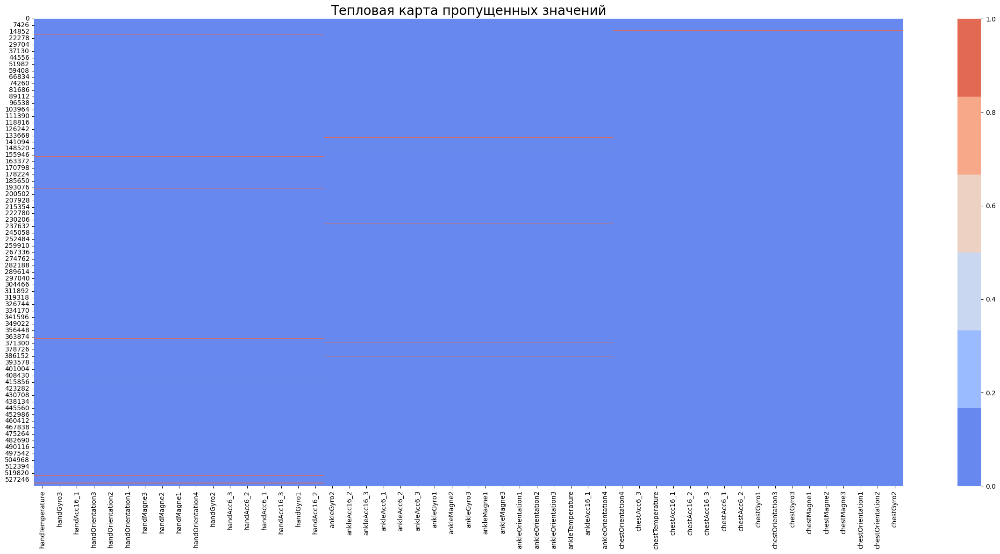

In [7]:
# Выводим суммарное количество пропусков
print('Суммарное количество пропусков в данных: {} \n'.format(PAM_df.isnull().sum().sum()))
print('-' * 50)

# Выводим признаки с сумрным количеством пропусков
print('Информация по количествам пропусков: \n\n{} \n'.format(PAM_df.isnull().sum()))
print('-' * 50)



# Построим тепловую карту пропусков
# Создаём функцию отображения пропущенных значений на тепловой карте
def missing_values_heatmap(data):
    
    # Рассчитываем количество пропусков
    cols_null_persent = data.isnull().mean() * 100
    cols_with_null = cols_null_persent[cols_null_persent > 0].sort_values(ascending = False)
    print(f'Информация по количествам пропусков в процентах:\n\n{cols_with_null}')
    print('-' * 50)
    
    # Задаём параметры графика
    colors = sns.color_palette('coolwarm')
    fig = plt.figure(figsize = (30, 13))
    cols = cols_with_null.index
    
    # Строим тепловую карту
    ax = sns.heatmap(
        data = data[cols].isnull(),
        cmap = sns.color_palette(colors)
    )
    
    # Задаём название графика
    plt.title('Тепловая карта пропущенных значений', fontsize = 20)
    
    return ax



# Применяем полученную функцию к нашему датасету
missing_values_heatmap(PAM_df)

**Вывод:**

Из полученной информации видно, что максимальное значение доли пропусков в данных не превышает $0.76$%. Поэтому заполним все пропуски средним значением:

In [7]:
# Заполняем пропуски средними значениями
PAM_df = PAM_df.fillna(PAM_df.mean())

Выведем количество пропусков:

In [8]:
# Выводим признаки с сумрным количеством пропусков
print('Информация по количествам пропусков: \n\n{} \n\n'.format(PAM_df.isnull().sum()))


# Выводим размерность таблицы
print('Размерность таблицы после удаления пропусков: {}'.format(PAM_df.shape))

Информация по количествам пропусков: 

timestamp            0
handTemperature      0
handAcc16_1          0
handAcc16_2          0
handAcc16_3          0
handAcc6_1           0
handAcc6_2           0
handAcc6_3           0
handGyro1            0
handGyro2            0
handGyro3            0
handMagne1           0
handMagne2           0
handMagne3           0
handOrientation1     0
handOrientation2     0
handOrientation3     0
handOrientation4     0
chestTemperature     0
chestAcc16_1         0
chestAcc16_2         0
chestAcc16_3         0
chestAcc6_1          0
chestAcc6_2          0
chestAcc6_3          0
chestGyro1           0
chestGyro2           0
chestGyro3           0
chestMagne1          0
chestMagne2          0
chestMagne3          0
chestOrientation1    0
chestOrientation2    0
chestOrientation3    0
chestOrientation4    0
ankleTemperature     0
ankleAcc16_1         0
ankleAcc16_2         0
ankleAcc16_3         0
ankleAcc6_1          0
ankleAcc6_2          0
ankleAcc6_3       

#### $2.2$

**Проверяем данные на наличие дубликатов:**

In [9]:
# Создаём список признаков
dupl_columns = list(PAM_df.columns)


# Создаём маску дубликатов с помощью метода duplicated() и произведём фильтрацию
mask = PAM_df.duplicated(subset = dupl_columns)
train_duplicates = PAM_df[mask]
print(f'Число найденных дубликатов: {train_duplicates.shape[0]}')

Число найденных дубликатов: 0


#### $2.3$

**Проверяем данные на наличие выбросов.**

Создадим список признаков с возможными выбросами:

In [10]:
# Создание списка признаков типа 'int64' и 'float64'
numeric_columns = PAM_df.select_dtypes(include = ['int64', 'float64']).columns.tolist()

Создадим функцию для поиска выбросов:

In [11]:
# Функция для поиска выбросов через IQR
def detect_outliers_iqr(data, features):
    
    # Создаём словарь, ключами которого будут индексы признаков,
    # а значениями - их количество
    outliers_dict = {}
    
    
    # Пройдёмся циклом for по признакам
    for feature in features:
        
        Q1 = data[feature].quantile(0.25)         # первый квартиль
        Q3 = data[feature].quantile(0.75)         # третий квартиль
        IQR = Q3 - Q1                             # межквартильный размах
        
        # Границы (нижняя и верхняя) для определения выбросов
        lower_bound = Q1 - 1.5 * IQR    
        upper_bound = Q3 + 1.5 * IQR   
        
        # Поиск выбросов
        outliers_dict[feature] = data[(data[feature] < lower_bound) | (data[feature] > upper_bound)][feature]  
        
    return outliers_dict

Организуем поиск выбросов:

In [12]:
# Создаём переменную, в котором будем хранить признаки с количеством выбросов
outliers = detect_outliers_iqr(
    data = PAM_df,
    features = numeric_columns
)


# Вывод выбросов
for feature, values in outliers.items():   
    print('"{}":   количество выбросов в признаке: {}'.format(feature, len(values)))
    print('-' * 55)
    print()

"timestamp":   количество выбросов в признаке: 0
-------------------------------------------------------

"handTemperature":   количество выбросов в признаке: 1
-------------------------------------------------------

"handAcc16_1":   количество выбросов в признаке: 4631
-------------------------------------------------------

"handAcc16_2":   количество выбросов в признаке: 35115
-------------------------------------------------------

"handAcc16_3":   количество выбросов в признаке: 7883
-------------------------------------------------------

"handAcc6_1":   количество выбросов в признаке: 4822
-------------------------------------------------------

"handAcc6_2":   количество выбросов в признаке: 35248
-------------------------------------------------------

"handAcc6_3":   количество выбросов в признаке: 7696
-------------------------------------------------------

"handGyro1":   количество выбросов в признаке: 158944
-------------------------------------------------------

"handG

Построим визуализации:

------------------------------------------------------------------------------------------------------------------------------------------------------
"Boxplot" для выбранных признаков:


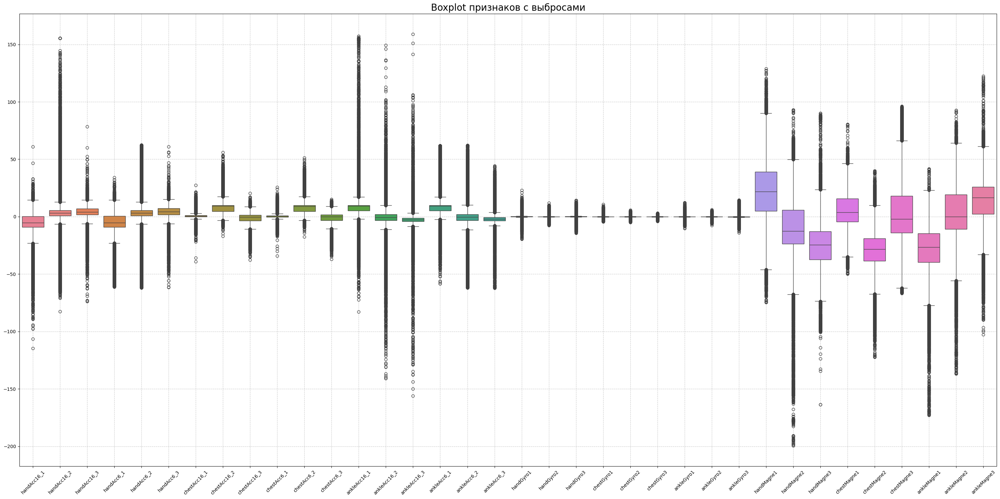

------------------------------------------------------------------------------------------------------------------------------------------------------
Точечные графики для различных пар признаков:


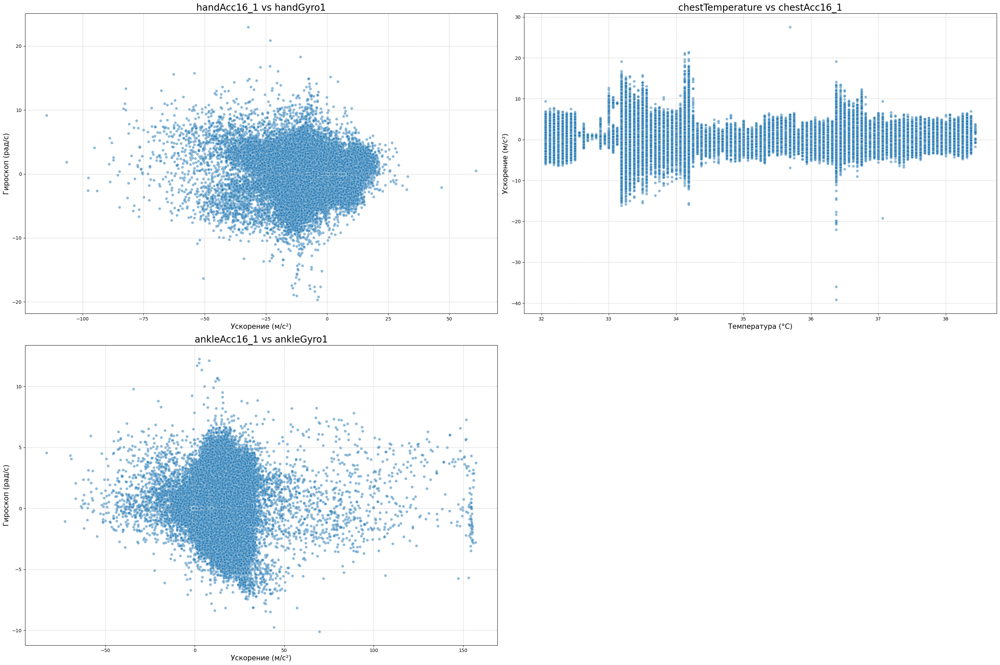

------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
# Выборка ключевых признаков для визуализации
features_to_plot = [
    'handAcc16_1', 'handAcc16_2', 'handAcc16_3', 'handAcc6_1', 'handAcc6_2', 'handAcc6_3', 
    'chestAcc16_1', 'chestAcc16_2', 'chestAcc16_3', 'chestAcc6_1', 'chestAcc6_2', 'chestAcc6_3',
    'ankleAcc16_1', 'ankleAcc16_2', 'ankleAcc16_3', 'ankleAcc6_1', 'ankleAcc6_2', 'ankleAcc6_3',
    'handGyro1', 'handGyro2', 'handGyro3', 'chestGyro1', 'chestGyro2', 'chestGyro3', 
    'ankleGyro1', 'ankleGyro2', 'ankleGyro3', 'handMagne1', 'handMagne2', 'handMagne3',
    'chestMagne1', 'chestMagne2', 'chestMagne3', 'ankleMagne1', 'ankleMagne2', 'ankleMagne3'
]



# График ящик с усами (boxplot) для выбранных признаков
print('-' * 150)
print('"Boxplot" для выбранных признаков:')

plt.rcParams['figure.figsize'] = (30, 15)
sns.boxplot(data = PAM_df[features_to_plot])
plt.xticks(rotation = 45)
plt.title('Boxplot признаков с выбросами', fontsize = 20)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.show()
print('-' * 150)



# Точечный график для пар признаков (scatter plot)
print('Точечные графики для различных пар признаков:')

# Точечный график для пар признаков (scatter plot)
plt.figure(figsize = (30, 20))

# Пример: Ускорение vs Гироскоп для руки
plt.subplot(2, 2, 1)
sns.scatterplot(data = PAM_df, x = 'handAcc16_1', y = 'handGyro1', alpha =  0.5)
plt.title('handAcc16_1 vs handGyro1', fontsize = 20)
plt.xlabel('Ускорение (м/с²)', fontsize = 15)
plt.ylabel('Гироскоп (рад/с)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)

# Пример: Температура vs Ускорение для груди
plt.subplot(2, 2, 2)
sns.scatterplot(data = PAM_df, x = 'chestTemperature', y = 'chestAcc16_1', alpha = 0.5)
plt.title('chestTemperature vs chestAcc16_1', fontsize = 20)
plt.xlabel('Температура (°C)', fontsize = 15)
plt.ylabel('Ускорение (м/с²)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)

# Пример: Ускорение vs Гироскоп для лодыжки
plt.subplot(2, 2, 3)
sns.scatterplot(data = PAM_df, x = 'ankleAcc16_1', y = 'ankleGyro1', alpha = 0.5)
plt.title('ankleAcc16_1 vs ankleGyro1', fontsize = 20)
plt.xlabel('Ускорение (м/с²)', fontsize = 15)
plt.ylabel('Гироскоп (рад/с)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)

plt.tight_layout()
plt.show()
print('-' * 150)

Проверим распределение признака `chestOrientation4`:

------------------------------------------------------------------------------------------------------------------------------------------------------
Гистограмма для признака "chestOrientation4":


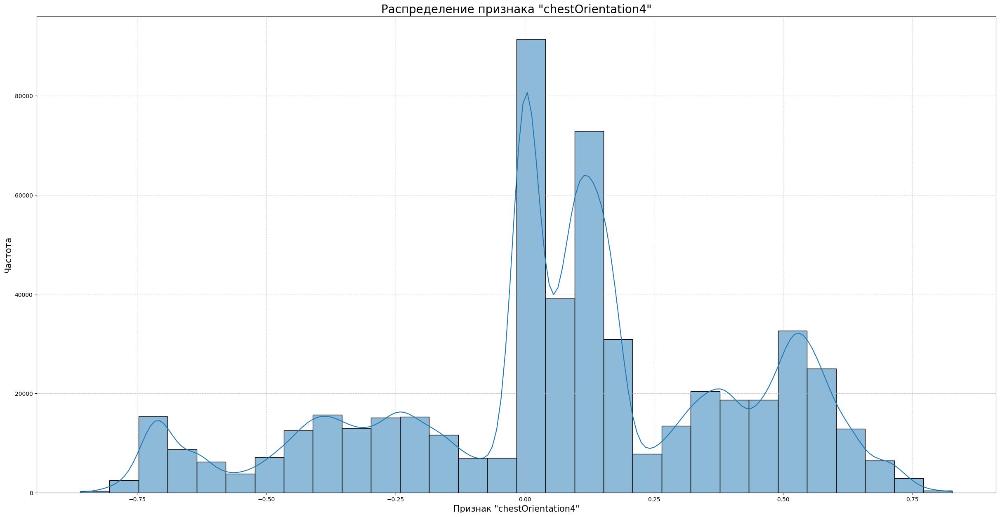

In [41]:
# Создаём заголовок для графика
print('-' * 150)
print('Гистограмма для признака "chestOrientation4":')



# Задаём размер графика
plt.rcParams['figure.figsize'] = (30, 15)

# Строим гистограмму для признака "chestOrientation4"
sns.histplot(
    PAM_df['chestOrientation4'],
    bins = 30,
    kde = True
)

# Задаём название графика и осей
plt.title('Распределение признака "chestOrientation4"', fontsize = 20)
plt.xlabel('Признак "chestOrientation4"', fontsize = 15)
plt.ylabel('Частота', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.show()

**Вывод:**

Из полученного графика видно, что распределение мультимодальное, что может быть связано с разными типами активности (например, ходьба, бег, приседания), которые влияют на ориентацию датчика на груди. Пики очень высокие (до 80 000 по частоте), что говорит о том, что большинство значений `chestOrientation4` сосредоточены в узких диапазонах.

**Обрабатываем выбросы.**

Применяем сглаживание для признаков `Acc`, `Gyro`, `Magne`:

In [13]:
# Создаём функцию 'smooth_data' для сглаживания
def smooth_data(data, columns, window = 5):
    
    
    """
    Функция для сглаживания данных с помощью скользящего среднего.
    
    Параметры:
        Исходные данные.
        Список признаков для сглаживания.
        Размер окна для скользящего среднего.
        
    """
    
    
    for col in columns:
        data[col + '_smoothed'] = data[col].rolling(window = window, center = True).mean()
        data[col + '_smoothed'] = data[col + '_smoothed'].bfill().ffill()
        
    return data




# Список признаков для сглаживания
features_to_smooth = [col for col in PAM_df.columns if 'Acc' in col or 'Gyro' in col or 'Magne' in col]

# Применяем сглаживание
PAM_df = smooth_data(PAM_df, features_to_smooth)

# Удаляем исходные столбцы и переименовываем сглаженные
for col in features_to_smooth:
    PAM_df[col] = PAM_df[col + '_smoothed']
    PAM_df = PAM_df.drop(columns = [col + '_smoothed'])

Проверяем распределение после обработки:

------------------------------------------------------------------------------------------------------------------------------------------------------
"Boxplot" для выбранных признаков:


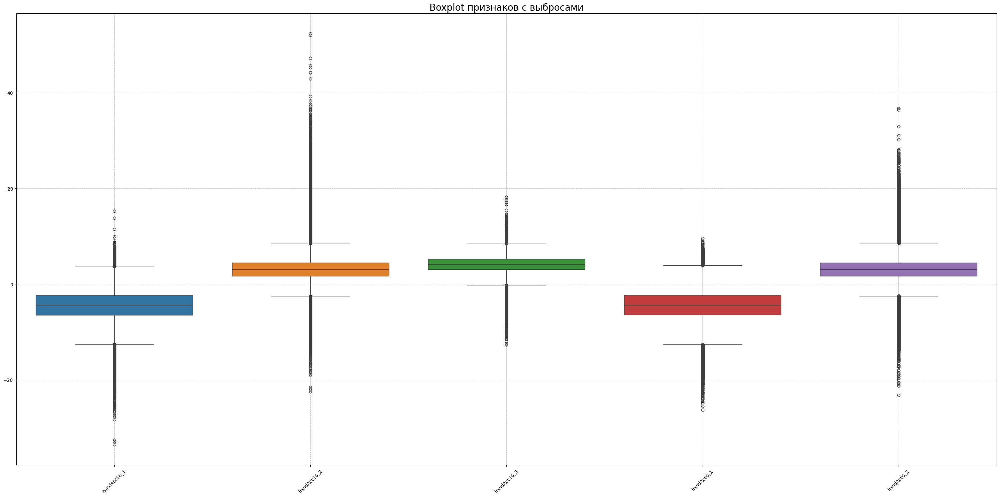

------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
# Создаём заголовок для графика
print('-' * 150)
print('"Boxplot" для выбранных признаков:')



# График ящик с усами (boxplot) для выбранных признаков
plt.rcParams['figure.figsize'] = (30, 15)
sns.boxplot(data = PAM_df[features_to_smooth[:5]])
plt.xticks(rotation = 45)
plt.title('Boxplot признаков с выбросами', fontsize = 20)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.show()

print('-' * 150)

Удалим выбросы из следующих признаков:

* `handTemperature`, 

* `ankleTemperature`, 

* `handMagne1`, 

* `handMagne3`, 

* `chestMagne2`,

* `chestMagne3`, 

* `ankleMagne1`,

* `ankleMagne2`, 

* `handOrientation2`,

* `handOrientation3`, 

* `chestOrientation2`, 

* `chestOrientation4`, 

* `ankleOrientation3`.

Были отобраны данные признаки, так как выбросов в них мало, и они могут быть ошибками (например, сбои датчика).

In [14]:
# Создаём функцию 'replace_outliers_iqr' для замены выбросов
def replace_outliers_iqr(data, column, k = 1.5):
    
    
    """
    Функция для замены выбросов в данных с помощью межквартильного размаха (IQR).
    
    Параметры:
        Исходные данные.
        Название признака для замены выбросов.
        Коэффициент для определения выбросов (по умолчанию 1.5).
        
    """
    
    
    # Рассчитываем межквартильный размах
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    
    # Рассчитываем нижнюю и верхнюю графицы доверительного интервала
    lower_bound = Q1 - k * IQR
    upper_bound = Q3 + k * IQR
    
    # Производим замену выбросов
    data[column] = np.where(
        (data[column] < lower_bound) | (data[column] > upper_bound),
        data[column].median(),
        data[column]
    )
    
    return data




# Применяем замену выбросов
features_to_replace = [
    'handTemperature', 'ankleTemperature', 'handMagne1', 'handMagne3', 'chestMagne2', 'chestMagne3', 'ankleMagne1', 'ankleMagne2',
    'handOrientation2', 'handOrientation3', 'chestOrientation2', 'chestOrientation4', 'ankleOrientation3',
]

for col in features_to_replace:
    PAM_df = replace_outliers_iqr(PAM_df, col)

Построим график:

------------------------------------------------------------------------------------------------------------------------------------------------------
"Boxplot" для выбранных признаков:


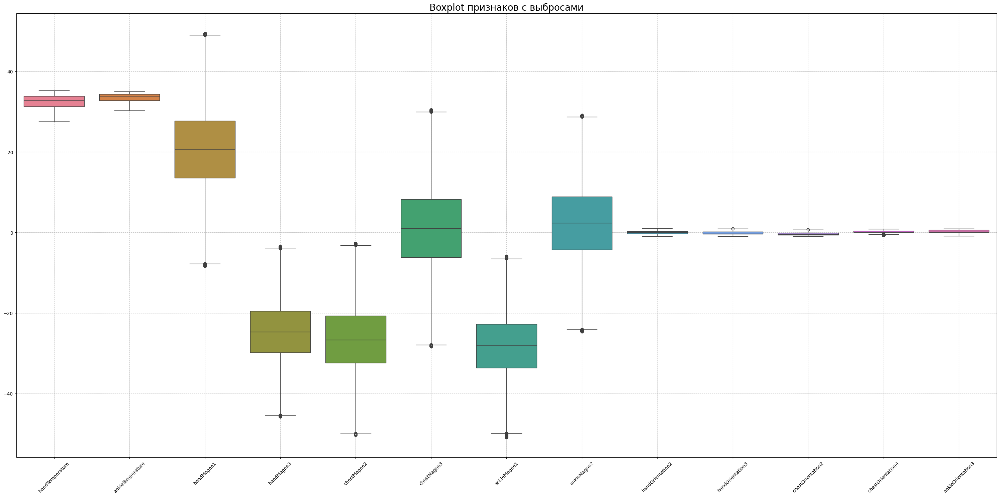

------------------------------------------------------------------------------------------------------------------------------------------------------


In [44]:
# Создаём заголовок для графика
print('-' * 150)
print('"Boxplot" для выбранных признаков:')



# График ящик с усами (boxplot) для выбранных признаков
plt.rcParams['figure.figsize'] = (30, 15)
sns.boxplot(data = PAM_df[features_to_replace])
plt.xticks(rotation = 45)
plt.title('Boxplot признаков с выбросами', fontsize = 20)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.show()

print('-' * 150)

Для оставшихся признаков после анализа применим логарифмирование.

**Вывод:**

В ходе обработки выбросов были обработаны, в основном, только те признаки, которые являются ключивыми для кластеризации движений, а именно: `Acc`, `Gyro` и `Magne`, так как они напрямую связаны с физической активностью.

## <CENTER> **`3.` Разведывательный анализ данных (EDA)**

В данной части проекта мы:

* изучаем сгенерированный набор данных;

* дополним наш анализ визуализациями, иллюстрирующими исследование.

#### $3.1$

**Гистограмма распределения признаков.**

Построим гистограммы для признаков `handAcc16_1`, `chestAcc16_1` и `ankleAcc16_1`, чтобы сравнить их распределения:

------------------------------------------------------------------------------------------------------------------------------------------------------
Гистограмма распределения ускорений.


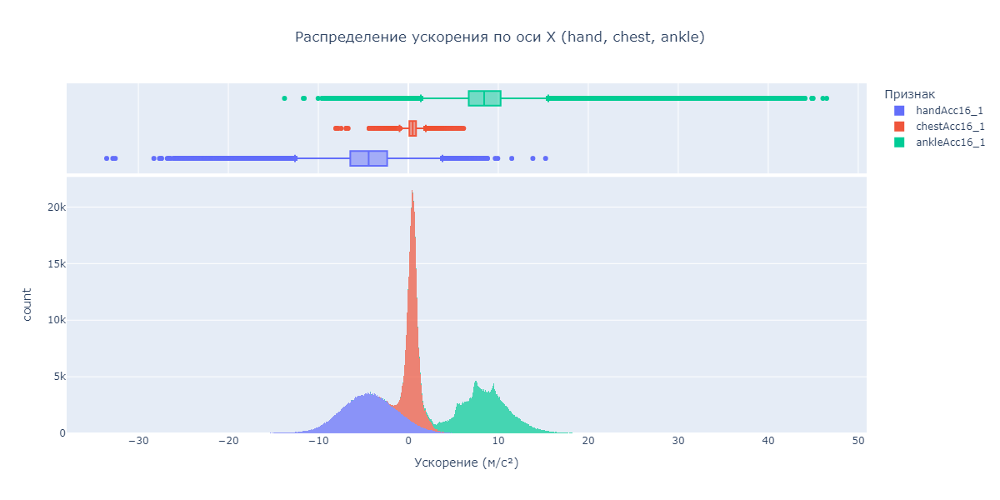

In [45]:
# Задаём заголовок для графика
print('-' * 150)
print('Гистограмма распределения ускорений.')



# Строим гистограмму для признаков 'handAcc16_1', 'chestAcc16_1', 'ankleAcc16_1'
fig = px.histogram(
    PAM_df,
    x = ['handAcc16_1', 'chestAcc16_1', 'ankleAcc16_1'],
    marginal = 'box',
    title = 'Распределение ускорения по оси X (hand, chest, ankle)',
    
    labels = {
        'value': 'Ускорение (м/с²)',
        'variable': 'Признак'
    },
    
    opacity = 0.7
)


# Настройка полотна
fig.update_layout(
    width = 1200,
    height = 600,
    title_x = 0.5,
    showlegend = True
)


# Отображаем график
fig.show('png')

**Вывод:**

Распределения ускорений по оси X для различных частей тела существенно отличаются. Грудь характеризуется стабильностью и низкой вариативностью ускорения. Рука и особенно лодыжка демонстрируют большее разнообразие и разброс значений, что связано с более активными движениями этих частей тела.

#### $3.2$

**Временная зависимость с цветом по субъектам.**

Построим временной график для `handAcc16_1`, раскрашенный по `subject_id`:

------------------------------------------------------------------------------------------------------------------------------------------------------
Точечный график зависимости ускорения и гироскопа (handAcc16_1 vs handGyro1).


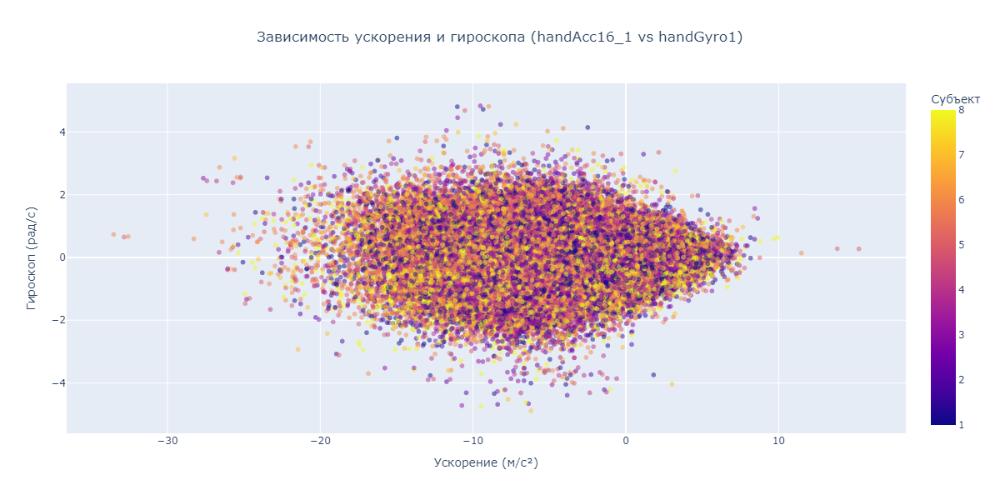

In [22]:
# Задаём заголовок для графика
print('-' * 150)
print('Точечный график зависимости ускорения и гироскопа (handAcc16_1 vs handGyro1).')



# Строим точечный график зависимости ускорения и гироскопа (handAcc16_1 vs handGyro1)
fig = px.scatter(
    PAM_df,
    x = 'handAcc16_1',
    y = 'handGyro1',
    color = 'subject_id',
    title = 'Зависимость ускорения и гироскопа (handAcc16_1 vs handGyro1)',
    
    labels = {
        'handAcc16_1': 'Ускорение (м/с²)',
        'handGyro1': 'Гироскоп (рад/с)',
        'subject_id': 'Субъект'
    },
    
    opacity = 0.5
)



# Настройка полотна
fig.update_layout(
    width = 1200,
    height = 600,
    title_x = 0.5,
    showlegend = True
)



# Отображаем график
fig.show('png')

**Вывод:**

В целом, данные показывают широкий диапазон значений как ускорения, так и гироскопа, что характерно для естественных движений руки. Отсутствие выраженной структуры говорит о том, что для выявления закономерностей между этими признаками могут потребоваться более сложные методы анализа или дополнительные признаки.

#### $3.3$

Построим комбинированный график, который покажет:

* **Круговая диаграмма**: Распределение данных по субъектам (`subject_id`), чтобы понять, насколько сбалансированы данные.

* **Столбчатая диаграмма**: Среднюю амплитуду ускорения (`handAcc16_magnitude`) для каждого субъекта, чтобы сравнить активность между ними.

------------------------------------------------------------------------------------------------------------------------------------------------------
Круговая и столбчатая диаграммы распределения данных и среднего ускорения по субъектам.


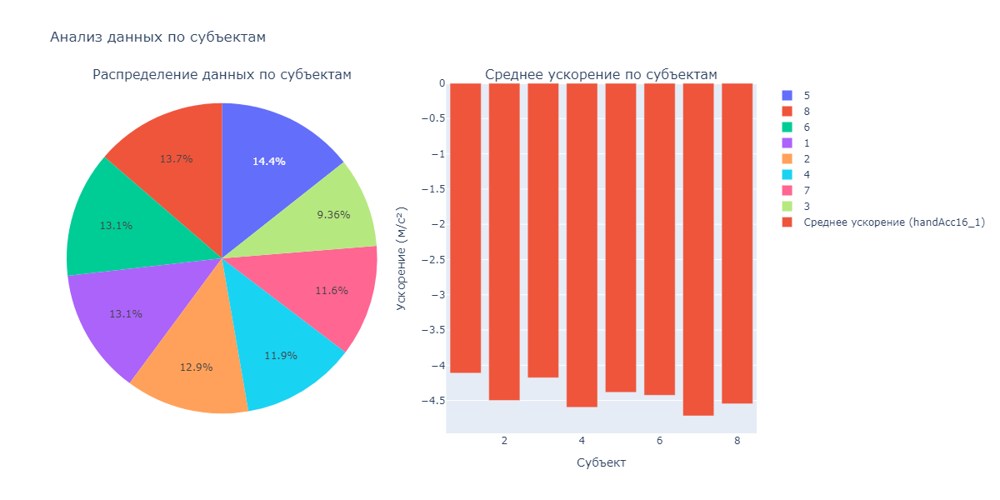

In [23]:
# Создаём заголовок для графика
print('-' * 150)
print('Круговая и столбчатая диаграммы распределения данных и среднего ускорения по субъектам.')



# Подготовка данных
# Распределение по субъектам (для круговой диаграммы)
subject_counts = PAM_df['subject_id'].value_counts()

# Средняя амплитуда ускорения по субъектам (для столбчатой диаграммы)
mean_acc_by_subject = PAM_df.groupby('subject_id')['handAcc16_1'].mean()



# Создаём подграфики
fig = make_subplots(
    rows = 1, cols = 2, 
    specs = [[{'type': 'pie'}, {'type': 'bar'}]], 
    subplot_titles=['Распределение данных по субъектам', 'Среднее ускорение по субъектам'])

# Круговая диаграмма
fig.add_trace(
    go.Pie(labels = subject_counts.index, values = subject_counts.values, name = 'Субъекты'),
    row = 1, col = 1
)

# Столбчатая диаграмма
fig.add_trace(
    go.Bar(x = mean_acc_by_subject.index, y = mean_acc_by_subject.values, name = 'Среднее ускорение (handAcc16_1)'),
    row = 1, col = 2
)



# Настраиваем оформление
fig.update_layout(
    title_text = 'Анализ данных по субъектам',
    showlegend = True,
    height = 600,
    width = 1200
)



# Настраиваем оси для столбчатой диаграммы
fig.update_yaxes(title_text = 'Ускорение (м/с²)', row = 1, col = 2)
fig.update_xaxes(title_text = 'Субъект', row = 1, col = 2)

fig.show('png')

**Вывод:**

Средние значения ускорения стабильны у всех субъектов — больших отличий между участниками не наблюдается, что говорит о похожем стиле движений или условиях эксперимента.

#### $3.4$

**Временной график с наложением температуры.**

Построим временной график, показывающий изменение температуры (`handTemperature`, `chestTemperature`, `ankleTemperature`) во времени для одного субъекта:

------------------------------------------------------------------------------------------------------------------------------------------------------
Временной график распределения температуры.


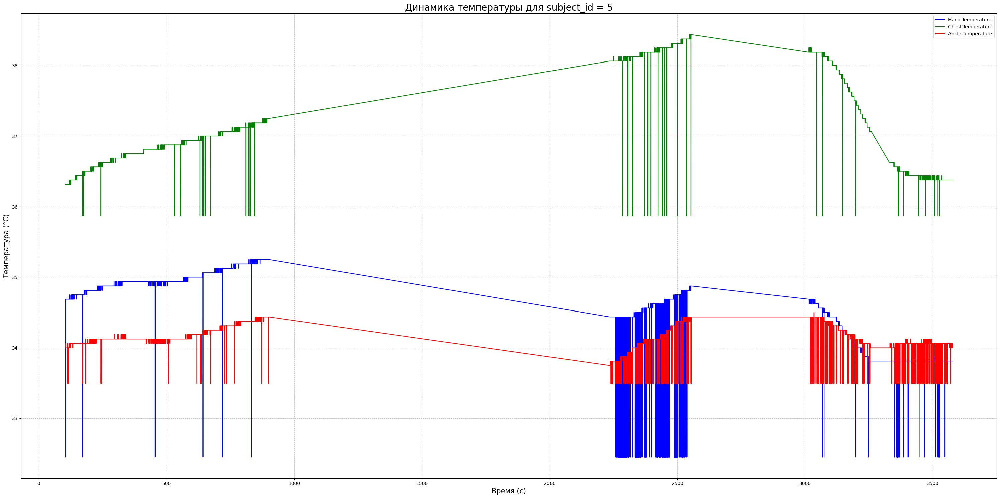

In [26]:
# Задаём загаловок графика
print('-' * 150)
print('Временной график распределения температуры.')


# Выбираем одного субъекта
subject_id = 5
subset = PAM_df[PAM_df['subject_id'] == subject_id]

# Задаём размер графика
plt.rcParams['figure.figsize'] = (30, 15)


# Линии для температуры
sns.lineplot(x = 'timestamp', y = 'handTemperature', data = subset, label = 'Hand Temperature', color = 'blue')
sns.lineplot(x = 'timestamp', y = 'chestTemperature', data = subset, label = 'Chest Temperature', color = 'green')
sns.lineplot(x = 'timestamp', y = 'ankleTemperature', data = subset, label = 'Ankle Temperature', color = 'red')


# Настраиваем оформление
plt.title(f'Динамика температуры для subject_id = {subject_id}', fontsize = 20)
plt.xlabel('Время (с)', fontsize = 15)
plt.ylabel('Температура (°C)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.legend()
plt.show()

**Вывод:**

Из полученного графика следует, что температура на разных участках тела существенно различается: грудь — самая тёплая, лодыжка — самая холодная. Также во всех сигналах видны резкие скачки и "шумы".

## <CENTER> **`4.` Feature engineering (Создание новых признаков)**

На данном этапе преобразуем некоторые из признаков.

#### $4.1$

**Выделение основных признаков.**

Так как в данных присутствуют значения для масштабов $±16g$ и $±6g$, проверим диапазон значений в `handAcc6` и `handAcc16`:

In [15]:
# Проверяем максимальные и минимальные значения handAcc6
print('Максимальные и минимальные значения для handAcc6:\n')

for hand_sensor in ['handAcc6_1', 'handAcc6_2', 'handAcc6_3']:
    print(f'{hand_sensor} min: {PAM_df[hand_sensor].min()}, max: {PAM_df[hand_sensor].max()}')
print('-' * 65)



# Проверяем максимальные и минимальные значения chestAcc6
print('Максимальные и минимальные значения для chestAcc6:\n')

for chest_sensor in ['chestAcc6_1', 'chestAcc6_2', 'chestAcc6_3']:
    print(f'{chest_sensor} min: {PAM_df[chest_sensor].min()}, max: {PAM_df[chest_sensor].max()}')
print('-' * 65)



# Проверяем максимальные и минимальные значения ankleAcc6
print('Максимальные и минимальные значения для ankleAcc6:\n')

for ankle_sensor in ['ankleAcc6_1', 'ankleAcc6_2', 'ankleAcc6_3']:
    print(f'{ankle_sensor} min: {PAM_df[ankle_sensor].min()}, max: {PAM_df[ankle_sensor].max()}')
print('-' * 65)

Максимальные и минимальные значения для handAcc6:

handAcc6_1 min: -26.274522000000026, max: 9.583152200000004
handAcc6_2 min: -23.191753599999988, max: 36.785348000000035
handAcc6_3 min: -10.59021799999999, max: 17.800010000000004
-----------------------------------------------------------------
Максимальные и минимальные значения для chestAcc6:

chestAcc6_1 min: -7.5342451999999955, max: 6.538852199999999
chestAcc6_2 min: -1.455760599999968, max: 23.564432000000025
chestAcc6_3 min: -12.902989000000005, max: 9.802755999999999
-----------------------------------------------------------------
Максимальные и минимальные значения для ankleAcc6:

ankleAcc6_1 min: -9.886452800000052, max: 39.75471399999994
ankleAcc6_2 min: -28.018241999999965, max: 24.586889600000056
ankleAcc6_3 min: -17.0920702, max: 13.442188600000014
-----------------------------------------------------------------


Так как максимальные и минимальные значения превышают $6g$, производить расчёты будем только для $16g$.

Выделим только необходимые признаки:

In [16]:
# Список столбцов для кластеризации
columns_to_keep = [
    'handTemperature', 'chestTemperature', 'ankleTemperature',
    'handAcc16_1', 'handAcc16_2', 'handAcc16_3',
    'chestAcc16_1', 'chestAcc16_2', 'chestAcc16_3',
    'ankleAcc16_1', 'ankleAcc16_2', 'ankleAcc16_3',
    'handGyro1', 'handGyro2', 'handGyro3',
    'chestGyro1', 'chestGyro2', 'chestGyro3',
    'ankleGyro1', 'ankleGyro2', 'ankleGyro3',
    'handMagne1', 'handMagne2', 'handMagne3',
    'chestMagne1', 'chestMagne2', 'chestMagne3',
    'ankleMagne1', 'ankleMagne2', 'ankleMagne3', 'subject_id'
]


# Фильтруем данные
PAM_df = PAM_df[columns_to_keep]

#### $4.2$

Для следующих признаков:

* Все признаки ускорения (`handAcc16_1`, ..., `ankleAcc6_3`),

* Все признаки гироскопа (`handGyro1`, ..., `ankleGyro3`),

* `chestMagne2`,

* `ankleMagne1`,

применим логарифмирование:

In [17]:
# Список признаков для преобразования
features_to_transform = [
    'handAcc16_1', 'handAcc16_2', 'handAcc16_3',
    'chestAcc16_1', 'chestAcc16_2', 'chestAcc16_3', 
    'ankleAcc16_1', 'ankleAcc16_2', 'ankleAcc16_3',
    'handGyro1', 'handGyro2', 'handGyro3', 
    'chestGyro1', 'chestGyro2', 'chestGyro3',
    'ankleGyro1', 'ankleGyro2', 'ankleGyro3'
]


# Логарифмическое преобразование
for feature in features_to_transform:
    PAM_df[feature] = np.log1p(PAM_df[feature].abs())

#### $4.3$

**Амплитуда ускорения и гироскопа.**

Для каждого датчика (рука, грудь, лодыжка) вычислим общую амплитуду ускорения и угловой скорости:

In [18]:
# Амплитуда ускорения
PAM_df['hand_acc16_magnitude'] = np.sqrt(PAM_df['handAcc16_1']**2 + PAM_df['handAcc16_2']**2 + PAM_df['handAcc16_3']**2)
PAM_df['chest_acc16_magnitude'] = np.sqrt(PAM_df['chestAcc16_1']**2 + PAM_df['chestAcc16_2']**2 + PAM_df['chestAcc16_3']**2)
PAM_df['ankle_acc16_magnitude'] = np.sqrt(PAM_df['ankleAcc16_1']**2 + PAM_df['ankleAcc16_2']**2 + PAM_df['ankleAcc16_3']**2)


# Амплитуда гироскопа
PAM_df['hand_gyro_magnitude'] = np.sqrt(PAM_df['handGyro1']**2 + PAM_df['handGyro2']**2 + PAM_df['handGyro3']**2)
PAM_df['chest_gyro_magnitude'] = np.sqrt(PAM_df['chestGyro1']**2 + PAM_df['chestGyro2']**2 + PAM_df['chestGyro3']**2)
PAM_df['ankle_gyro_magnitude'] = np.sqrt(PAM_df['ankleGyro1']**2 + PAM_df['ankleGyro2']**2 + PAM_df['ankleGyro3']**2)

Построим визуализацию распределения:

------------------------------------------------------------------------------------------------------------------------------------------------------
Гистограмма распределения амплитуды ускорения.


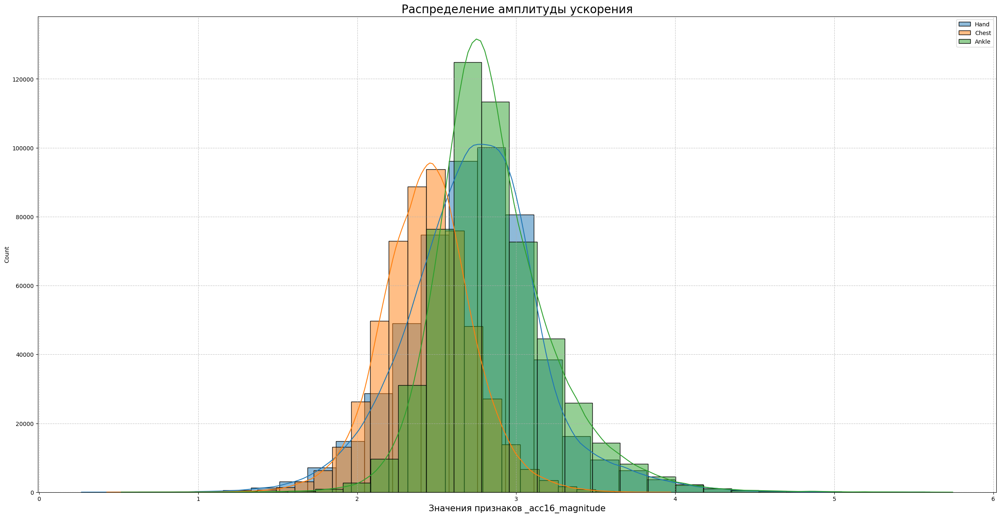

In [52]:
# Задаём заголовок для графика
print('-' * 150)
print('Гистограмма распределения амплитуды ускорения.')


# Задаём размер графика
plt.rcParams['figure.figsize'] = (30, 15)


# Строим гистограмму для амплитуды ускорения
sns.histplot(PAM_df['hand_acc16_magnitude'], kde = True, bins = 30, label = 'Hand')
sns.histplot(PAM_df['chest_acc16_magnitude'], kde = True, bins = 30, label = 'Chest')
sns.histplot(PAM_df['ankle_acc16_magnitude'], kde = True, bins = 30, label = 'Ankle')


# Настраиваем оформление
plt.title('Распределение амплитуды ускорения', fontsize = 20)
plt.xlabel('Значения признаков _acc16_magnitude', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**

* **Грудная область** характеризуется самой низкой и стабильной амплитудой ускорения.

* **Рука и лодыжка** демонстрируют более высокие и разнообразные значения ускорения, что связано с их большей подвижностью.

Все три распределения имеют правосторонний "хвост" (асимметрию), что может быть связано с отдельными резкими движениями.

#### $4.4$

**Статистики по временным окнам.**

Вычислим статистики (среднее, стандартное отклонение, минимум, максимум) для каждого датчика в скользящем окне (например, 1 секунда или 50 строк, если частота 50 Гц):

In [19]:
# Задаём размер окна для скользящего среднего
window_size = 50  


# Среднее и стандартное отклонение для амплитуды ускорения
PAM_df['hand_acc16_magnitude_mean'] = PAM_df['hand_acc16_magnitude'].rolling(window = window_size).mean()
PAM_df['hand_acc16_magnitude_std'] = PAM_df['hand_acc16_magnitude'].rolling(window = window_size).std()
PAM_df['chest_acc16_magnitude_mean'] = PAM_df['chest_acc16_magnitude'].rolling(window = window_size).mean()
PAM_df['chest_acc16_magnitude_std'] = PAM_df['chest_acc16_magnitude'].rolling(window = window_size).std()
PAM_df['ankle_acc16_magnitude_mean'] = PAM_df['ankle_acc16_magnitude'].rolling(window = window_size).mean()
PAM_df['ankle_acc16_magnitude_std'] = PAM_df['ankle_acc16_magnitude'].rolling(window = window_size).std()


# Заполняем пропуски
PAM_df = PAM_df.bfill().ffill()

#### $4.5$

**Средняя температура в скользящем окне.**

Вычислим среднюю температуру в скользящем окне (например, 100 секунд) для каждого датчика:

In [20]:
# Задаём размер окна для скользящего среднего
window_size = 100


# Средняя температура в скользящем окне
PAM_df['hand_temp_mean'] = PAM_df['handTemperature'].rolling(window = window_size).mean()
PAM_df['chest_temp_mean'] = PAM_df['chestTemperature'].rolling(window = window_size).mean()
PAM_df['ankle_temp_mean'] = PAM_df['ankleTemperature'].rolling(window = window_size).mean()


# Заполняем пропуски
PAM_df['hand_temp_mean'] = PAM_df['hand_temp_mean'].bfill().ffill()
PAM_df['chest_temp_mean'] = PAM_df['chest_temp_mean'].bfill().ffill()
PAM_df['ankle_temp_mean'] = PAM_df['ankle_temp_mean'].bfill().ffill()

Построим график зависимости температуры от ускорения `chestTemperature` и `chest_acc16_magnitude`, чтобы проверить, коррелирует ли температура с интенсивностью движений:

------------------------------------------------------------------------------------------------------------------------------------------------------
Точечный график зависимости температуры от ускорения.


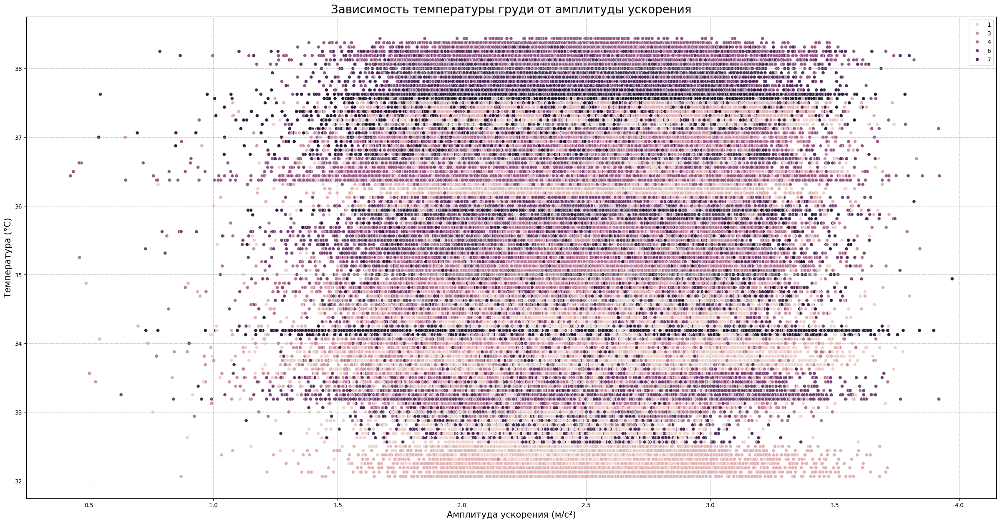

In [57]:
# Задаём заголовок для графика
print('-' * 150)
print('Точечный график зависимости температуры от ускорения.')


# Задаём размер графика
plt.rcParams['figure.figsize'] = (30, 15)


# Строим точечный график зависимости температуры от амплитуды ускорения
sns.scatterplot(
    data = PAM_df,
    x = 'chest_acc16_magnitude',
    y = 'chestTemperature',
    hue = 'subject_id'
)


# Настраиваем оформление
plt.title('Зависимость температуры груди от амплитуды ускорения', fontsize = 20)
plt.xlabel('Амплитуда ускорения (м/с²)', fontsize = 15)
plt.ylabel('Температура (°C)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**

По данному графику можно сделать вывод, что корреляция между температурой груди и интенсивностью движений отсутствует или крайне слаба.

#### $4.6$

**Разница температуры между датчиками.**

Рассчитаем разницу температуры между датчиками чтобы понять, как тепло распределяется по телу во время активности:

In [21]:
# Разница температуры между датчиками
PAM_df['temp_diff_hand_chest'] = PAM_df['handTemperature'] - PAM_df['chestTemperature']
PAM_df['temp_diff_hand_ankle'] = PAM_df['handTemperature'] - PAM_df['ankleTemperature']
PAM_df['temp_diff_chest_ankle'] = PAM_df['chestTemperature'] - PAM_df['ankleTemperature']

#### $4.7$

**Изменение температуры.**

Резкие изменения температуры (например, рост на груди в первые 2000 секунд) могут быть связаны с началом или окончанием активности. Вычислим производную температуры:

In [22]:
# Изменение температуры (производная)
PAM_df['hand_temp_change'] = PAM_df['handTemperature'].diff()
PAM_df['chest_temp_change'] = PAM_df['chestTemperature'].diff()
PAM_df['ankle_temp_change'] = PAM_df['ankleTemperature'].diff()


# Заполняем пропуски
PAM_df['hand_temp_change'] = PAM_df['hand_temp_change'].bfill().ffill()
PAM_df['chest_temp_change'] = PAM_df['chest_temp_change'].bfill().ffill()
PAM_df['ankle_temp_change'] = PAM_df['ankle_temp_change'].bfill().ffill()

#### $4.8$

**Стандартное отклонение температуры в скользящем окне.**

Стандартное отклонение температуры может показать, насколько температура колеблется, что может быть связано с изменением активности:

In [23]:
# Стандартное отклонение температуры в скользящем окне
PAM_df['hand_temp_std'] = PAM_df['handTemperature'].rolling(window = window_size).std()
PAM_df['chest_temp_std'] = PAM_df['chestTemperature'].rolling(window = window_size).std()
PAM_df['ankle_temp_std'] = PAM_df['ankleTemperature'].rolling(window = window_size).std()


# Заполняем пропуски
PAM_df['hand_temp_std'] = PAM_df['hand_temp_std'].bfill().ffill()
PAM_df['chest_temp_std'] = PAM_df['chest_temp_std'].bfill().ffill()
PAM_df['ankle_temp_std'] = PAM_df['ankle_temp_std'].bfill().ffill()

#### $4.9$

**Максимальная и минимальная температура в окне.**

Максимальная и минимальная температура в скользящем окне могут показать пиковые значения, связанные с интенсивностью активности:

In [24]:
# Максимальная и минимальная температура в скользящем окне
PAM_df['hand_temp_max'] = PAM_df['handTemperature'].rolling(window = window_size).max()
PAM_df['hand_temp_min'] = PAM_df['handTemperature'].rolling(window = window_size).min()
PAM_df['chest_temp_max'] = PAM_df['chestTemperature'].rolling(window = window_size).max()
PAM_df['chest_temp_min'] = PAM_df['chestTemperature'].rolling(window = window_size).min()
PAM_df['ankle_temp_max'] = PAM_df['ankleTemperature'].rolling(window = window_size).max()
PAM_df['ankle_temp_min'] = PAM_df['ankleTemperature'].rolling(window = window_size).min()


# Заполняем пропуски
PAM_df['hand_temp_max'] = PAM_df['hand_temp_max'].bfill().ffill()
PAM_df['hand_temp_min'] = PAM_df['hand_temp_min'].bfill().ffill()
PAM_df['chest_temp_max'] = PAM_df['chest_temp_max'].bfill().ffill()
PAM_df['chest_temp_min'] = PAM_df['chest_temp_min'].bfill().ffill()
PAM_df['ankle_temp_max'] = PAM_df['ankle_temp_max'].bfill().ffill()
PAM_df['ankle_temp_min'] = PAM_df['ankle_temp_min'].bfill().ffill()

#### $4.10$

**Температурный градиент между началом и концом периода.**

Вычислим разницу температуры между началом и концом определённого периода (например, каждые 500 секунд), чтобы понять общий тренд:

In [25]:
# Задаём разницу температуры каждые 500 секунд
period_size = 500
PAM_df['chest_temp_trend'] = np.nan

for i in range(period_size, len(PAM_df), period_size):
    start_idx = max(0, i - period_size)
    end_idx = i
    temp_diff = PAM_df['chestTemperature'].iloc[end_idx] - PAM_df['chestTemperature'].iloc[start_idx]
    PAM_df.loc[start_idx:end_idx, 'chest_temp_trend'] = temp_diff



# Заполняем пропуски
PAM_df['chest_temp_trend'] = PAM_df['chest_temp_trend'].bfill().ffill()

#### $4.11$

**Частотные характеристики.**

Создадим функции для расчёта частотных характеристик:

In [26]:
# Создаём функцию 'dominant_frequency()' для создания признаков доминантной частоты
def dominant_frequency(signal, sample_rate = 32):
    
    signal = np.array(signal)                    # преобразуем в массив
    N = len(signal)                              # вычисляем длину сигнала
    
    if N < 2:                                    # проверка на случай, если окно слишком маленькое
        return np.nan
    
    yf = fft(signal)                             # вычисляем БПФ
    xf = fftfreq(N, 1 / sample_rate)[: N // 2]   # вычисляем частоты
    power = np.abs(yf[: N // 2])                 # вычисляем мощность сигнала
    dominant_freq = xf[np.argmax(power)]         # находим доминантную частоту
    
    return dominant_freq




# Создаём функцию 'signal_energy' для создания признаков энергии сигнала
def signal_energy(signal):
    
    signal = np.array(signal)                    # преобразуем в массив
    energy_signal = np.sum(np.square(signal))    # вычисляем энергию сигнала
    
    return energy_signal

Вычисляем частотные характеристики:

In [27]:
# Создаём список признаков для анализа
features_list = [
    'handAcc16_1', 'handAcc16_2', 'handAcc16_3',
    'chestAcc16_1', 'chestAcc16_2', 'chestAcc16_3',
    'ankleAcc16_1', 'ankleAcc16_2', 'ankleAcc16_3'
]


# Задаём размер скользящего окна (30 секунд при частоте 32 Гц)
window_size = 30 * 32




# Вычисляем частотные характеристики и энергию с помощью скользящего окна
for sensor in features_list:
    
    PAM_df[f'{sensor}_dominant_freq'] = (
        PAM_df[sensor]
        .rolling(window = window_size, min_periods = window_size)
        .apply(dominant_frequency, raw = True)
    )
    
    PAM_df[f'{sensor}_energy'] = (
        PAM_df[sensor]
        .rolling(window = window_size, min_periods = window_size)
        .apply(signal_energy, raw = True)
    )




# Заполняем NaN средними значениями
for sensor in features_list:
    
    PAM_df[f'{sensor}_dominant_freq'] = PAM_df[f'{sensor}_dominant_freq'].fillna(
        PAM_df[f'{sensor}_dominant_freq'].mean()
    )
    
    PAM_df[f'{sensor}_energy'] = PAM_df[f'{sensor}_energy'].fillna(
        PAM_df[f'{sensor}_energy'].mean()
    )

Выведем результаты:

In [28]:
# Выводим значения для 'dominant frequency'
print('Значения для "dominant frequency":\n')
print(PAM_df[[f'{sensor}_dominant_freq' for sensor in features_list]].head())
print('-' * 65)


# Выводим значения для 'signal energy'
print('Значения для "signal energy":\n')
print(PAM_df[[f'{sensor}_energy' for sensor in features_list]].head())
print('-' * 65)

Значения для "dominant frequency":

   handAcc16_1_dominant_freq  handAcc16_2_dominant_freq  \
0                        0.0                        0.0   
1                        0.0                        0.0   
2                        0.0                        0.0   
3                        0.0                        0.0   
4                        0.0                        0.0   

   handAcc16_3_dominant_freq  chestAcc16_1_dominant_freq  \
0                        0.0                         0.0   
1                        0.0                         0.0   
2                        0.0                         0.0   
3                        0.0                         0.0   
4                        0.0                         0.0   

   chestAcc16_2_dominant_freq  chestAcc16_3_dominant_freq  \
0                         0.0                         0.0   
1                         0.0                         0.0   
2                         0.0                         0.0   
3   

Построим визуализацию распределения доминантных частот:

------------------------------------------------------------------------------------------------------------------------------------------------------
Гистограмма распределения доминантных частот.


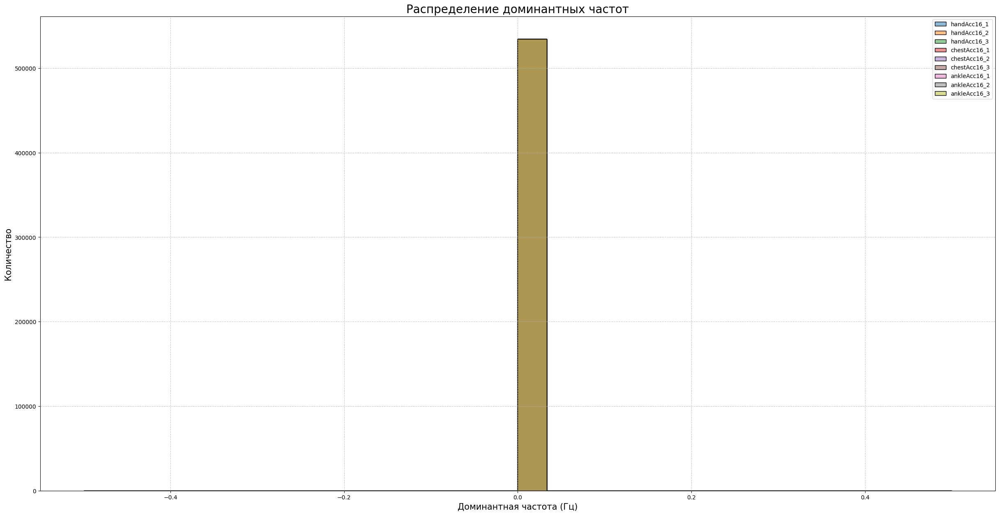

In [30]:
# Задаём заглавие графика
print('-' * 150)
print('Гистограмма распределения доминантных частот.')

# Задаём размер полотна
plt.rcParams['figure.figsize'] = (30, 15)



# Создаём график
for sensor in features_list:
    
    sns.histplot(
        PAM_df[f'{sensor}_dominant_freq'],
        kde = True,
        bins = 30,
        label = sensor,
        alpha = 0.5
    )
    
    
    
# Настраиваем оформление
plt.title('Распределение доминантных частот', fontsize = 20)
plt.xlabel('Доминантная частота (Гц)', fontsize = 15)
plt.ylabel('Количество', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**

Из полученного графика следует, что доминантная частота почти всегда равна нулю для всех сенсоров.

Построим визуализацию распределения энергии сигнала:

------------------------------------------------------------------------------------------------------------------------------------------------------
Гистограмма распределения энергии сигнала.


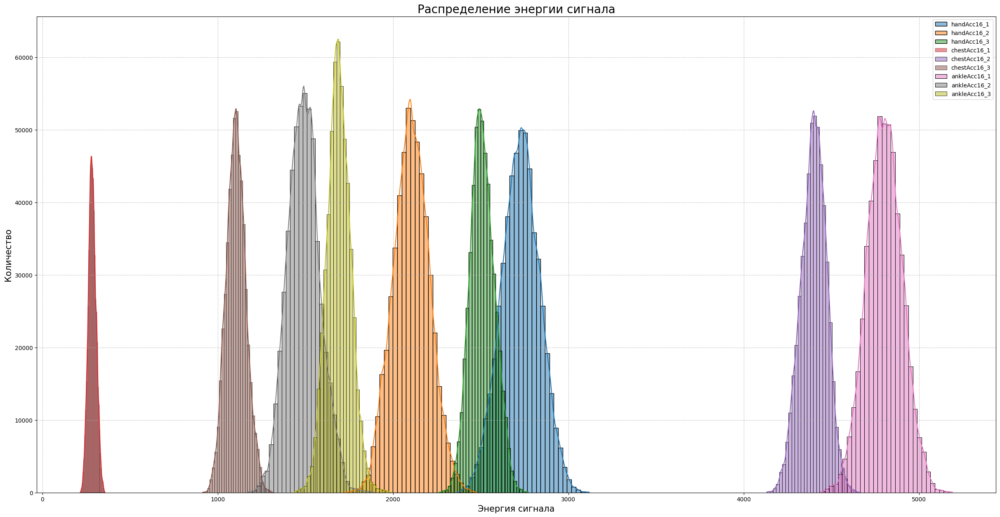

In [31]:
# Задаём заглавие графика
print('-' * 150)
print('Гистограмма распределения энергии сигнала.')

# Задаём размер полотна
plt.rcParams['figure.figsize'] = (30, 15)



# Создаём график
for sensor in features_list:
    
    sns.histplot(
        PAM_df[f'{sensor}_energy'],
        kde = True,
        bins = 30,
        label = sensor,
        alpha = 0.5
    )
    
    
    
# Настраиваем оформление
plt.title('Распределение энергии сигнала', fontsize = 20)
plt.xlabel('Энергия сигнала', fontsize = 15)
plt.ylabel('Количество', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**

Энергия сигнала существенно различается между сенсорами, расположенными на разных частях тела. Сенсоры на руке фиксируют самые низкие значения энергии, на груди — средние, на лодыжке — самые высокие.

При создании признаков доминантных частот большинство из них оказались с нулевыми значениями, удалим их:

In [29]:
# Список признаков для удаления
features_to_remove = [
    'handAcc16_1_dominant_freq',
    'handAcc16_2_dominant_freq',
    'handAcc16_3_dominant_freq',
    'chestAcc16_1_dominant_freq',
    'chestAcc16_2_dominant_freq',
    'ankleAcc16_1_dominant_freq',
    'ankleAcc16_3_dominant_freq'
]


# Удаляем указанные признаки
PAM_df = PAM_df.drop(columns = features_to_remove, errors = 'ignore')

#### $4.12$

Создадим признаки медианных, минимальных и максимальных значений статистики: 

In [30]:
# Создаём список признаков для анализа
features_list = [
    'handAcc16_1', 'handAcc16_2', 'handAcc16_3',
    'chestAcc16_1', 'chestAcc16_2', 'chestAcc16_3',
    'ankleAcc16_1', 'ankleAcc16_2', 'ankleAcc16_3',
    'handGyro1', 'handGyro2', 'handGyro3'
]



# Задаём размер скользящего окна (30 секунд при частоте 32 Гц)
window_size = 30 * 32

# Вычисляем частотные характеристики и энергию с помощью скользящего окна
for sensor in features_list:
    
    PAM_df[f'{sensor}_median'] = (
        PAM_df[sensor]
        .rolling(window = window_size, min_periods = window_size)
        .median()
    )
    
    PAM_df[f'{sensor}_min'] = (
        PAM_df[sensor]
        .rolling(window = window_size, min_periods = window_size)
        .min()
    )
    
    PAM_df[f'{sensor}_max'] = (
        PAM_df[sensor]
        .rolling(window = window_size, min_periods = window_size)
        .max()
    )
    
    # Запоняем образовавшиеся пропуски
    PAM_df[f'{sensor}_median'] = PAM_df[f'{sensor}_median'].fillna(PAM_df[f'{sensor}_median'].mean())
    PAM_df[f'{sensor}_min'] = PAM_df[f'{sensor}_min'].fillna(PAM_df[f'{sensor}_min'].mean())
    PAM_df[f'{sensor}_max'] = PAM_df[f'{sensor}_max'].fillna(PAM_df[f'{sensor}_max'].mean())

C:\Users\User\AppData\Local\Temp\ipykernel_9756\1913838974.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  PAM_df[f'{sensor}_median'] = (
C:\Users\User\AppData\Local\Temp\ipykernel_9756\1913838974.py:23: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  PAM_df[f'{sensor}_min'] = (
C:\Users\User\AppData\Local\Temp\ipykernel_9756\1913838974.py:29: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once u

#### $4.13$

#### **Энтропия сигнала.**

Создадим признаки энтропии сигнала, так как они могут помочь различать хаотичные движения (переходы) и регулярные (ходьба, бег):

In [31]:
# Создаём функцию 'signal_entropy()' для создания признаков энтропии сигнала
def signal_entropy(signal):
    
    """
    Функция для вычисления энтропии сигнала.
    
    Параметры:
        Исходные данные.
        
    """
    
    
    signal = np.array(signal)   # преобразуем в массив
    
    if len(signal) < 2:         # проверка на случай, если окно слишком маленькое
        return np.nan
    
    hist, _ = np.histogram(     # вычисляем гистограмму
        signal,
        bins = 50,
        density = True
    )
    
    return stats.entropy(hist)




# Разбиваем данные на непересекающиеся окна
PAM_df['window'] = (PAM_df.index // window_size).astype(int)

# Вычисляем энтропию для каждого окна
for sensor in features_list:
    
    # Группируем по окнам и применяем signal_entropy
    entropy_per_window = (
        PAM_df.groupby('window')[sensor]
        .apply(signal_entropy)
    )
    
    # Создаём столбец с энтропией, повторяя значение для всех строк в окне
    PAM_df[f'{sensor}_entropy'] = PAM_df['window'].map(entropy_per_window)

    # Заполняем NaN средними значениями
    PAM_df[f'{sensor}_entropy'] = PAM_df[f'{sensor}_entropy'].fillna(
        PAM_df[f'{sensor}_entropy'].mean()
    )



# Удаляем временный столбец window
PAM_df = PAM_df.drop(columns = ['window'])

C:\Users\User\AppData\Local\Temp\ipykernel_9756\3367700812.py:30: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  PAM_df['window'] = (PAM_df.index // window_size).astype(int)
C:\Users\User\AppData\Local\Temp\ipykernel_9756\3367700812.py:42: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  PAM_df[f'{sensor}_entropy'] = PAM_df['window'].map(entropy_per_window)
C:\Users\User\AppData\Local\Temp\ipykernel_9756\3367700812.py:42: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many t

## <CENTER> **`5.` Отбор признаков**

На данном этапе проведём корреляционный анализмежду признаками, по необходимости избавимся от мультиколлинеарности, проведём нормализацию и отберём только самые информативные признаки для дальнейшего исследования.

#### $5.1$

**Отбор самых информативных признаков.**

Для начала отберём только признаки с высокой дисперсией:

In [32]:
# Выделяем признаки с дисперсией > 0.25
variances = PAM_df.var()
high_variance_features = variances[variances > variances.quantile(0.25)].index.tolist()


# Оставляем признаки с дисперсией выше 25-го перцентиля
PAM_df = PAM_df[high_variance_features]
print(f'Выбрано признаков с высокой дисперсией: {len(high_variance_features)}')

Выбрано признаков с высокой дисперсией: 90


Теперь выделим только те признаки, которые характеризуют энергию и энтропию, так как они хорошо отражают интенсивность и сложность движений, что важно для различения активностей (например, покой vs бег):

In [33]:
# Список выбранных признаков
selected_features = [
    
    # Признаки энергии
    'handAcc16_1_energy', 'handAcc16_2_energy', 'handAcc16_3_energy',
    'chestAcc16_1_energy', 'chestAcc16_2_energy', 'chestAcc16_3_energy',
    'ankleAcc16_1_energy', 'ankleAcc16_2_energy', 'ankleAcc16_3_energy',
    
    # Признаки энтропии
    'handAcc16_2_entropy', 'chestAcc16_1_entropy', 'chestAcc16_2_entropy',
    'ankleAcc16_1_entropy', 'ankleAcc16_3_entropy',
    'handGyro1_entropy', 'handGyro2_entropy', 'handGyro3_entropy'
]



# Фильтруем данные
PAM_df_selected = PAM_df[selected_features]

# Выводим информацию о выбранных признаках
PAM_df_selected.info()
print('-' * 60)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 534601 entries, 0 to 534600
Data columns (total 17 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   handAcc16_1_energy    534601 non-null  float64
 1   handAcc16_2_energy    534601 non-null  float64
 2   handAcc16_3_energy    534601 non-null  float64
 3   chestAcc16_1_energy   534601 non-null  float64
 4   chestAcc16_2_energy   534601 non-null  float64
 5   chestAcc16_3_energy   534601 non-null  float64
 6   ankleAcc16_1_energy   534601 non-null  float64
 7   ankleAcc16_2_energy   534601 non-null  float64
 8   ankleAcc16_3_energy   534601 non-null  float64
 9   handAcc16_2_entropy   534601 non-null  float64
 10  chestAcc16_1_entropy  534601 non-null  float64
 11  chestAcc16_2_entropy  534601 non-null  float64
 12  ankleAcc16_1_entropy  534601 non-null  float64
 13  ankleAcc16_3_entropy  534601 non-null  float64
 14  handGyro1_entropy     534601 non-null  float64
 15  

#### $5.2$

Для начала проведём корреляционный анализ. Построим тепловую карту корреляций признаков:

In [34]:
# Создаём функцию 'heatmap_corr()' для построения тепловой карты корреляции
def heatmap_corr(data, title = 'Correlation Heatmap', figsize = (30, 30)):
    
    
    """
    Функция для построения тепловой карты корреляции.
    
    Параметры:
    data (DataFrame): Данные для анализа.
    title (str): Заголовок графика.
    figsize (tuple): Размер графика.
    
    """
    
    
    # Задаём размер полотна
    plt.rcParams['figure.figsize'] = figsize
    
    # Строим тепловую карту
    sns.heatmap(
        data.corr(),
        annot = True,
        fmt = '.2f',
        cmap = 'coolwarm',
        vmin = -1, 
        vmax = 1, 
        center = 0,
        square = True,
        cbar_kws = {'shrink': .8},
        linewidths = 0.5
    )
    
    # Настраиваем параметры
    plt.title(title, fontsize = 20)
    plt.tight_layout()
    
    # Выводим график
    plt.show()

Строим тепловую карту:

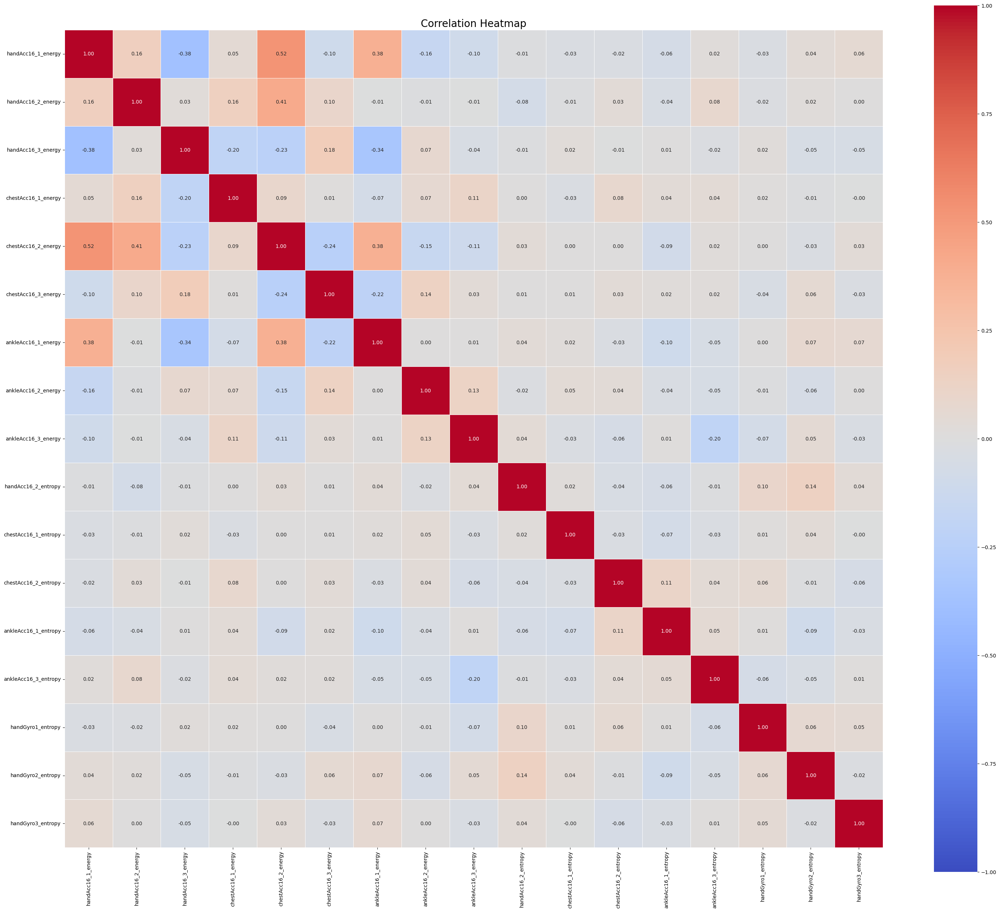

In [35]:
# Применяем функцию 'heatmap_corr()' для построения тепловой карты корреляции
heatmap_corr(PAM_df_selected)

**Вывод:**

Исходя из полученной карты видно, что предельные значения корреляции между многими признаками составляют $(+-)0.52$. Высококоррелированные связи отсутствуют.

#### $5.3$

**Стандартизация признаков.**

Построим график распределения признаков:

In [36]:
# Создаём функцию 'features_distribution_plot()' для построения графика распределения признаков
def features_distribution_plot(data, title = 'Распределение до нормализации', figsize = (30, 17)):
    
    
    """
    Функция для построения графиков распределения признаков.
    
    Параметры:
    - data: pandas DataFrame с данными.
    - features: список признаков для анализа.
    - title: заголовок графика.
    - figsize: размер графика.
    
    """
    
    
    # Задаём размер графика
    fig, ax = plt.subplots(figsize = figsize)

    # Построение плотностей распределения
    for column in data.columns:
    
        sns.kdeplot(
            data[column], 
            label = column, 
            ax = ax
        )



    # Настройка легенды: выносим за пределы графика
    plt.legend(
        bbox_to_anchor = (1.05, 1),
        loc = 'upper left',
        fontsize = 10
    )

    # Настройка графика
    plt.title(title, fontsize = 20)
    plt.xlabel('Значение', fontsize = 15)
    plt.ylabel('Плотность', fontsize = 15)
    plt.grid(True, linestyle = '--', alpha = 0.7)
    plt.tight_layout()  
    plt.show()

Строим график распределения:

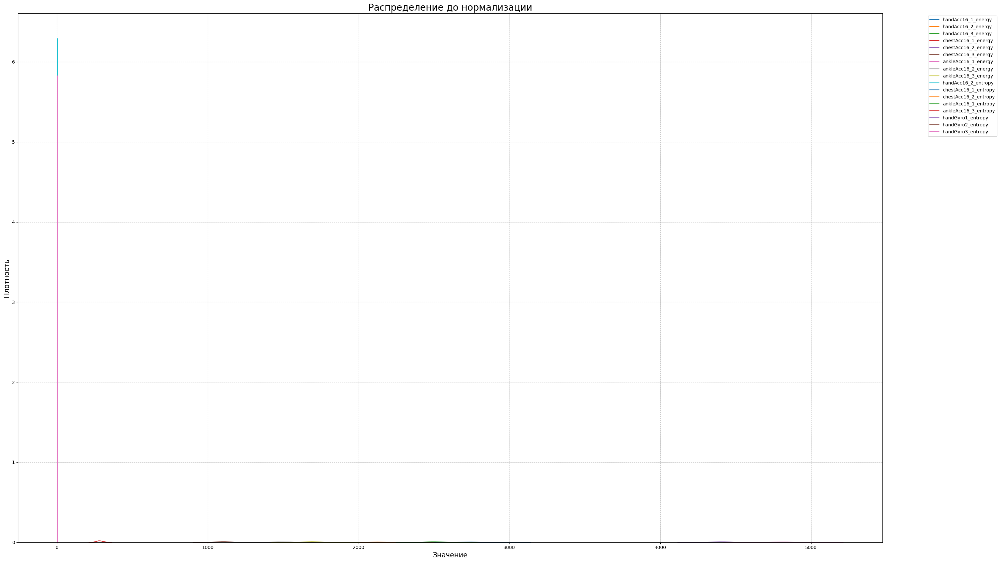

In [37]:
# Применяем функцию 'features_distribution_plot()' для построения графика распределения признаков
features_distribution_plot(data = PAM_df_selected)

**Вывод:**

Большинство значений признаков сосредоточены около $0$ (сильный пик в начале), так же присутствует длинный "хвост" с редкими значениями, доходящими до $100000$, что делает данное распределение сильно скошенным вправо.

Применим логарифмическое преобразование, чтобы сделать распределение более нормальным:

In [38]:
# Создаём список признаков с высокими значениями
features_high_values = [
    'handAcc16_1_energy', 'handAcc16_2_energy', 'handAcc16_3_energy',
    'chestAcc16_1_energy', 'chestAcc16_2_energy', 'chestAcc16_3_energy',
    'ankleAcc16_1_energy', 'ankleAcc16_2_energy', 'ankleAcc16_3_energy'
]


# Логарифмическое преобразование
for feature in features_high_values:
    PAM_df_selected[feature] = np.log1p(PAM_df_selected[feature])

C:\Users\User\AppData\Local\Temp\ipykernel_9756\2103351760.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  PAM_df_selected[feature] = np.log1p(PAM_df_selected[feature])


Строим график распределения:

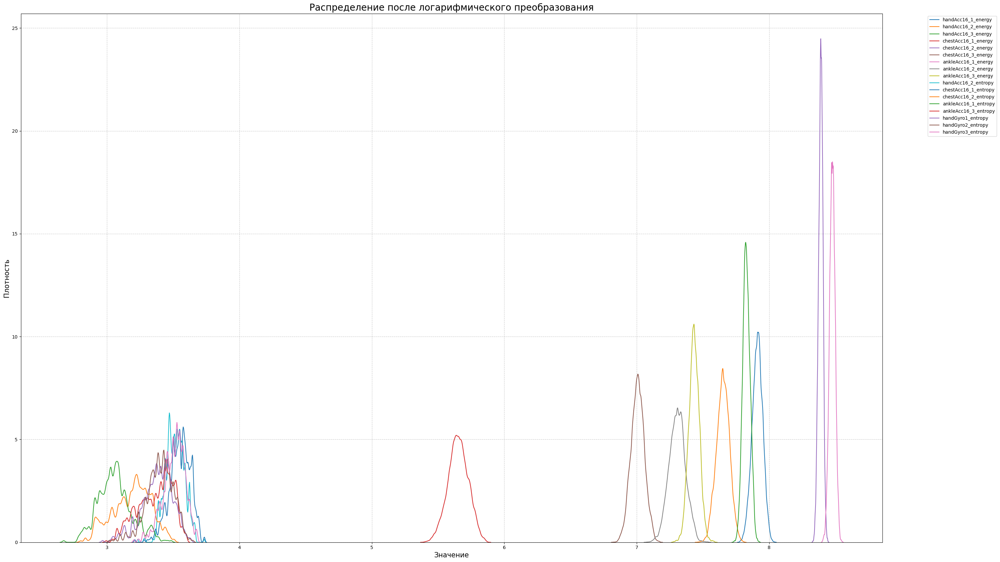

In [39]:
# Применяем функцию 'features_distribution_plot()' для построения графика распределения признаков
features_distribution_plot(data = PAM_df_selected, title = 'Распределение после логарифмического преобразования')

Произведём стандартизацию признаков при помощи алгоритма `StandardScaller()`:

In [40]:
# Проводим стандартизацию
scaler = preprocessing.StandardScaler()
PAM_df_scaled = scaler.fit_transform(PAM_df_selected)


# Создаём новый DataFrame с стандартизированными данными
PAM_df_scaled = pd.DataFrame(PAM_df_scaled, columns = PAM_df_selected.columns)


# Проверяем результат
print('Первые 5 строк после стандартизации:\n')
display(PAM_df_scaled.head())
print('-' * 150)

print(f'Средние значения признаков:\n\n{PAM_df_scaled.mean()}')
print('-' * 40)

print(f'Стандартные отклонения признаков\n\n{PAM_df_scaled.std()}')
print('-' * 40)

Первые 5 строк после стандартизации:



,handAcc16_1_energy,handAcc16_2_energy,handAcc16_3_energy,chestAcc16_1_energy,chestAcc16_2_energy,chestAcc16_3_energy,ankleAcc16_1_energy,ankleAcc16_2_energy,ankleAcc16_3_energy,handAcc16_2_entropy,chestAcc16_1_entropy,chestAcc16_2_entropy,ankleAcc16_1_entropy,ankleAcc16_3_entropy,handGyro1_entropy,handGyro2_entropy,handGyro3_entropy
0,0.019928,0.024596,0.01387,0.038456,0.008356,0.025376,0.010638,0.031053,0.020049,-0.072936,1.479881,0.30055,-0.817632,-1.117783,-0.418476,0.660351,0.193915
1,0.019928,0.024596,0.01387,0.038456,0.008356,0.025376,0.010638,0.031053,0.020049,-0.072936,1.479881,0.30055,-0.817632,-1.117783,-0.418476,0.660351,0.193915
2,0.019928,0.024596,0.01387,0.038456,0.008356,0.025376,0.010638,0.031053,0.020049,-0.072936,1.479881,0.30055,-0.817632,-1.117783,-0.418476,0.660351,0.193915
3,0.019928,0.024596,0.01387,0.038456,0.008356,0.025376,0.010638,0.031053,0.020049,-0.072936,1.479881,0.30055,-0.817632,-1.117783,-0.418476,0.660351,0.193915
4,0.019928,0.024596,0.01387,0.038456,0.008356,0.025376,0.010638,0.031053,0.020049,-0.072936,1.479881,0.30055,-0.817632,-1.117783,-0.418476,0.660351,0.193915


------------------------------------------------------------------------------------------------------------------------------------------------------
Средние значения признаков:

handAcc16_1_energy     -4.847354e-14
handAcc16_2_energy      3.147244e-14
handAcc16_3_energy     -4.395883e-14
chestAcc16_1_energy    -5.727713e-15
chestAcc16_2_energy    -7.061926e-15
chestAcc16_3_energy     1.191604e-14
ankleAcc16_1_energy     1.706346e-13
ankleAcc16_2_energy     3.166893e-14
ankleAcc16_3_energy    -2.170083e-14
handAcc16_2_entropy    -2.943178e-15
chestAcc16_1_entropy    8.898860e-15
chestAcc16_2_entropy   -3.418254e-15
ankleAcc16_1_entropy    2.787938e-15
ankleAcc16_3_entropy    7.922337e-15
handGyro1_entropy      -7.554227e-15
handGyro2_entropy      -3.518629e-15
handGyro3_entropy      -1.059544e-14
dtype: float64
----------------------------------------
Стандартные отклонения признаков

handAcc16_1_energy      1.000001
handAcc16_2_energy      1.000001
handAcc16_3_energy      1.000001
ch

Выведем график после стандартизации:

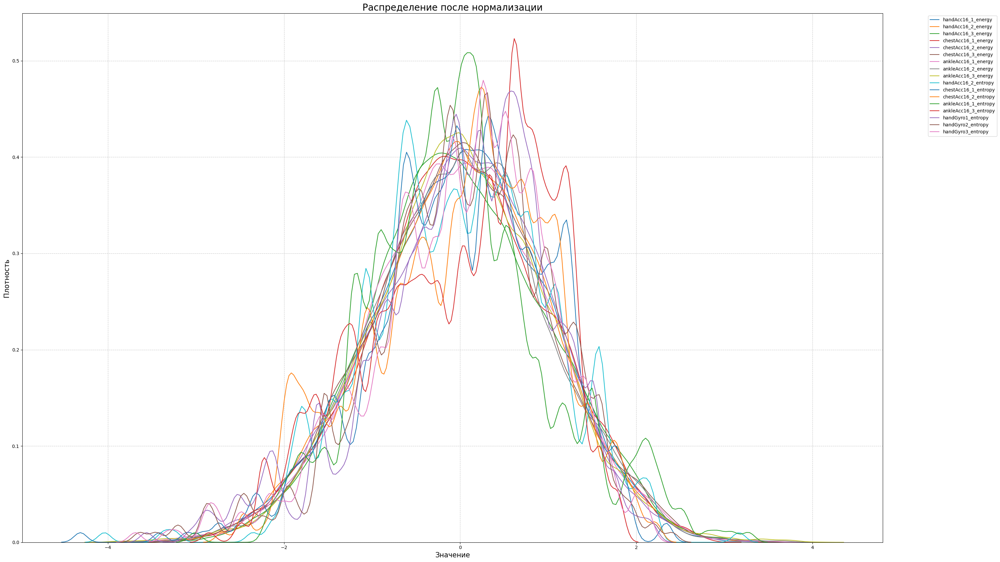

In [43]:
# Применяем функцию 'features_distribution_plot()' для построения графика распределения признаков
features_distribution_plot(
    data = PAM_df_scaled, 
    title = 'Распределение после нормализации'
)

#### $5.5$

#### **Используем `PCA` для подбора необходимого количества компонент.**

Построим график кумулятивной объяснённой дисперсии:

------------------------------------------------------------------------------------------------------------------------------------------------------
График кумулятивной объяснённой дисперсии.


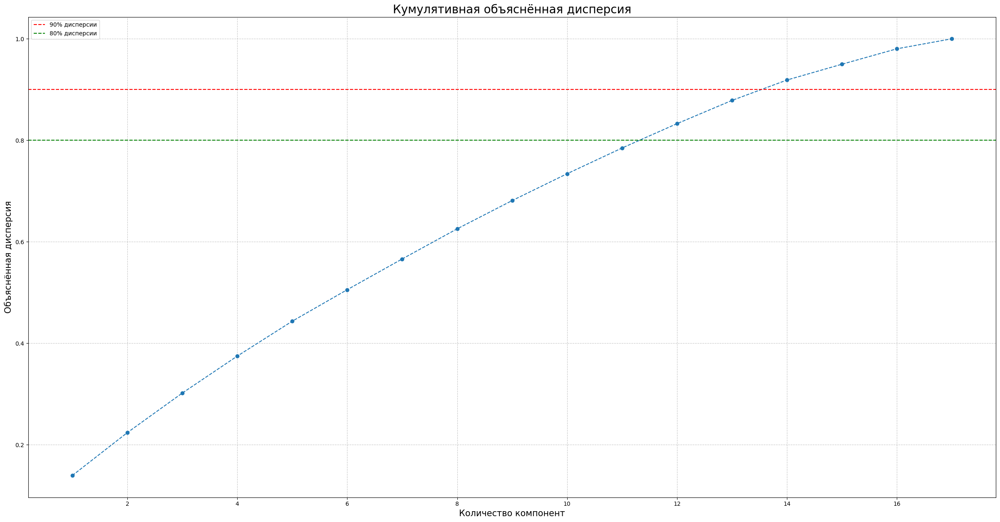

In [ ]:
# Заголовок графика
print('-' * 150)
print('График кумулятивной объяснённой дисперсии.')



# Применяем PCA без ограничения на количество компонент
pca = decomposition.PCA()
pca.fit(PAM_df_scaled)


# Кумулятивная объяснённая дисперсия
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)


# Построение графика
plt.rcParams['figure.figsize'] = (30, 15)
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker = 'o', linestyle = '--')
plt.axhline(y = 0.90, color = 'r', linestyle = '--', label = '90% дисперсии')
plt.axhline(y = 0.80, color = 'g', linestyle = '--', label = '80% дисперсии')
plt.axvline(x = 14, color = 'g', linestyle = '--', label = '14 компонент')
plt.title('Кумулятивная объяснённая дисперсия', fontsize = 20)
plt.xlabel('Количество компонент', fontsize = 15)
plt.ylabel('Объяснённая дисперсия', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**



Умньшим размерность с помощью $PCA$:

In [41]:
# Уменьшаем размерность с помощью PCA
pca = decomposition.PCA(n_components = 0.90)  
features_pca = pca.fit_transform(PAM_df_scaled)


# Создаём новый DataFrame
PAM_df_pca = pd.DataFrame(
    features_pca,
    columns = [f'PC{i + 1}' for i in range(features_pca.shape[1])],
    index = PAM_df_scaled.index
)


# Выводим количество признаков и объяснённую дисперсию
print(f'Количество признаков после PCA: {features_pca.shape[1]}')
print(f'Объяснённая дисперсия: {sum(pca.explained_variance_ratio_)}')

Количество признаков после PCA: 14
Объяснённая дисперсия: 0.9187465966608682


## <CENTER> **`6.` Machine Learning**

На данном этапе мы построим несколько подходящих моделей и выявим наилучшую.

#### $6.1$

#### **K-Means**

Воспользуемся методом *k-means*.

Подберём оптимальное количество кластеров для метода *k-means* с помощью коэффициента силуэта, перебирая возможные значения от 1 до 15 включительно. В качестве значения параметра *random_state* возьмём число 42. Остальные параметры оставим по умолчанию:

In [46]:
# Создаём список для значений количества кластеров
inertias_list = []
K_values = range(1, 15)



# Проходимся циклом по всем нужным нам значениям количества кластеров
for k in K_values:
    
    # Создаём объект класса KMeans
    KM_model = cluster.KMeans(
        n_clusters = k,
        random_state = 42
    )
    
    # Oбучаем модель k-means с текущим количеством кластеров
    KM_model.fit_predict(PAM_df_pca)
    
    # Добавляем значения в список
    inertias_list.append(KM_model.inertia_)
    
    # Выводим информацию о текущем количестве кластеров
    print(f'Количество кластеров "k" = {k}: {KM_model.inertia_:.2f}')

Количество кластеров "k" = 1: 8349768.44
Количество кластеров "k" = 2: 7536408.36
Количество кластеров "k" = 3: 7230789.33
Количество кластеров "k" = 4: 6975891.25
Количество кластеров "k" = 5: 6772540.65
Количество кластеров "k" = 6: 6577624.09
Количество кластеров "k" = 7: 6450390.43
Количество кластеров "k" = 8: 6327928.59
Количество кластеров "k" = 9: 6199053.27
Количество кластеров "k" = 10: 6088669.92
Количество кластеров "k" = 11: 5986680.46
Количество кластеров "k" = 12: 5908093.24
Количество кластеров "k" = 13: 5820094.03
Количество кластеров "k" = 14: 5757901.15


Строим визуализацию:

------------------------------------------------------------------------------------------------------------------------------------------------------
График метода локтя для выбора K.


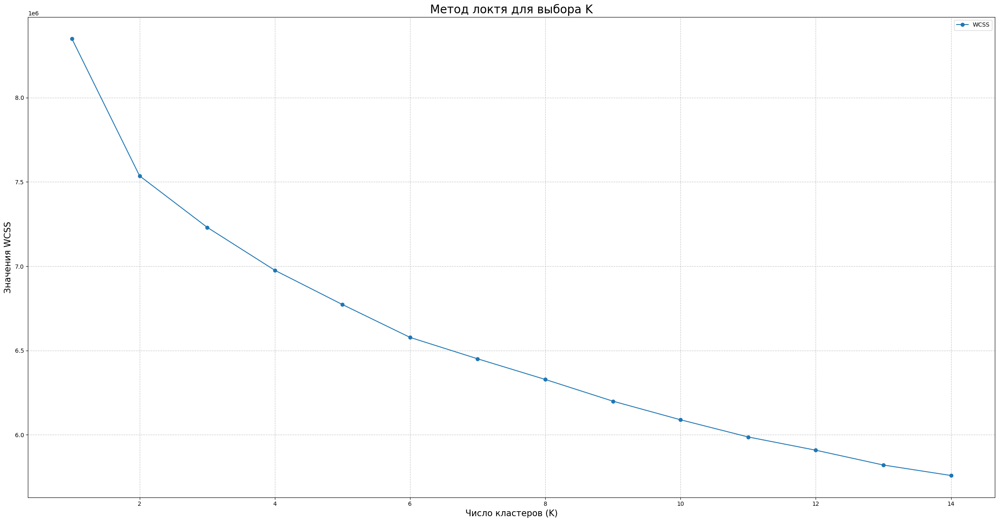

In [47]:
# Заголовок графика
print('-' * 150)
print('График метода локтя для выбора K.')



# Строим график
plt.rcParams['figure.figsize'] = (30, 15)

plt.plot(
    K_values,
    inertias_list,
    marker = 'o',
    linestyle = '-',
    label = 'WCSS'
)

plt.title('Метод локтя для выбора K', fontsize = 20)
plt.xlabel('Число кластеров (K)', fontsize = 15)
plt.ylabel('Значения WCSS', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

**Вывод:**

Оптимальное 𝑘 находится в диапазоне $4$–$5$, так как после 𝑘 = $5$ снижение WCSS становится менее значительным. Выберем 𝑘 = $4$, так как это точка, где снижение `inertia` замедляется.

Чтобы подтвердить выбор, вычислим `Silhouette Score` для разных значений 𝑘:

In [48]:
# Silhouette Score на подвыборке
sample_size = 10000
np.random.seed(42)
sample_indices = np.random.choice(range(features_pca.shape[0]), size = sample_size)
features_sample = features_pca[sample_indices]

# Создаём список, в котором будем хранить значения Silhouette Score
silhouette_scores = []



# Проходимся циклом for по значениям K_values
for k in K_values[1:]:  # Начинаем с k = 2
    
    kmeans = cluster.KMeans(n_clusters = k, random_state = 42)
    labels = kmeans.fit_predict(PAM_df_pca)
    labels_sample = labels[sample_indices]
    score = metrics.silhouette_score(features_sample, labels_sample)
    silhouette_scores.append(score)
    
    print(f'Silhouette Score для "k" = {k}: {score:.4f}')

Silhouette Score для "k" = 2: 0.0910
Silhouette Score для "k" = 3: 0.0655
Silhouette Score для "k" = 4: 0.0600
Silhouette Score для "k" = 5: 0.0579
Silhouette Score для "k" = 6: 0.0602
Silhouette Score для "k" = 7: 0.0606
Silhouette Score для "k" = 8: 0.0592
Silhouette Score для "k" = 9: 0.0586
Silhouette Score для "k" = 10: 0.0617
Silhouette Score для "k" = 11: 0.0626
Silhouette Score для "k" = 12: 0.0647
Silhouette Score для "k" = 13: 0.0648
Silhouette Score для "k" = 14: 0.0634


Строим визуализацию:

------------------------------------------------------------------------------------------------------------------------------------------------------
График метода локтя для выбора K.


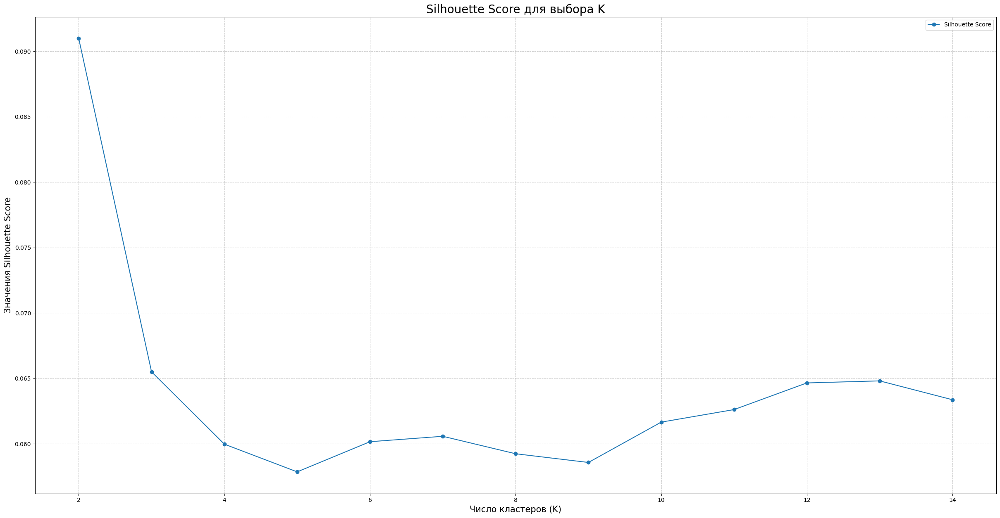

In [49]:
# Заголовок графика
print('-' * 150)
print('График метода локтя для выбора K.')



# Строим график
plt.rcParams['figure.figsize'] = (30, 15)

plt.plot(
    list(K_values)[1:],
    silhouette_scores,
    marker = 'o',
    linestyle = '-',
    label = 'Silhouette Score'
)

plt.title('Silhouette Score для выбора K', fontsize = 20)
plt.xlabel('Число кластеров (K)', fontsize = 15)
plt.ylabel('Значения Silhouette Score', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend()
plt.show()

Теперь отобразим оба графика на одном:

------------------------------------------------------------------------------------------------------------------------------------------------------
График метода локтя и Silhouette Score для выбора K.


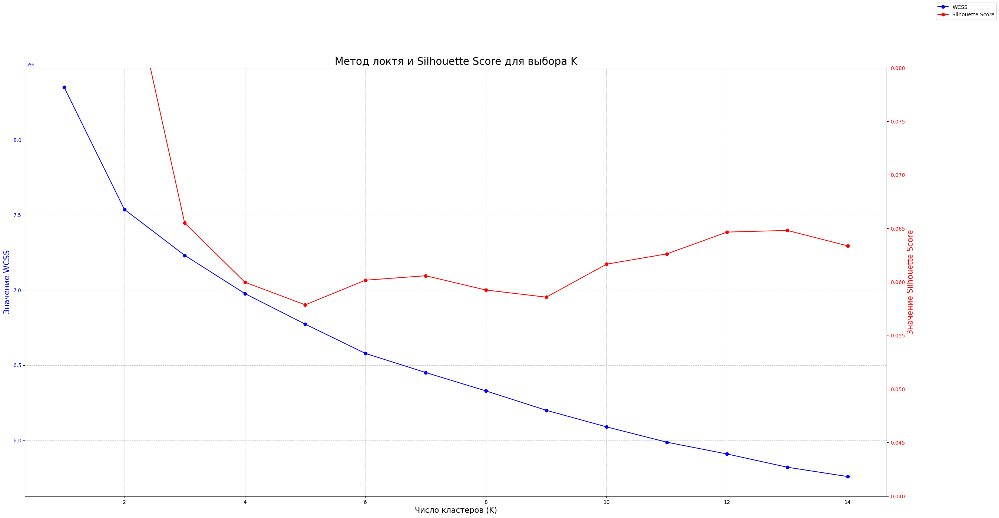

In [50]:
# Заголовок графика
print('-' * 150)
print('График метода локтя и Silhouette Score для выбора K.')



# Строим оба графика
fig, ax1 = plt.subplots(figsize = (30, 15))


# График метода локтя
ax1.plot(K_values, inertias_list, marker = 'o', linestyle = '-', color = 'b', label = 'WCSS')
ax1.set_xlabel('Число кластеров (K)', fontsize = 15)
ax1.set_ylabel('Значение WCSS', fontsize = 15, color = 'b')
ax1.tick_params(axis = 'y', labelcolor = 'b')
ax1.grid(True, linestyle = '--', alpha = 0.7)


# График Silhouette Score
ax2 = ax1.twinx()
ax2.plot(list(K_values)[1:], silhouette_scores, marker = 'o', linestyle = '-', color = 'r', label = 'Silhouette Score')
ax2.set_ylabel('Значение Silhouette Score', fontsize = 15, color = 'r')
ax2.tick_params(axis = 'y', labelcolor = 'r')
ax2.set_ylim(0.04, 0.08)


plt.title('Метод локтя и Silhouette Score для выбора K', fontsize = 20)
fig.legend(loc = 'upper right')
plt.show()

**Вывод:**

На основе графика `Silhouette Score` можно сделать вывод, что 𝑘 = $4$ выглядит как лучший выбор.

Визуализируем кластеры для 𝑘 = $2$, 𝑘 = $3$, 𝑘 = $4$, 𝑘 = $5$ и 𝑘 = $6$ чтобы выбрать лучший вариант:

------------------------------------------------------------------------------------------------------------------------------------------------------
График количества кластеров K = 2


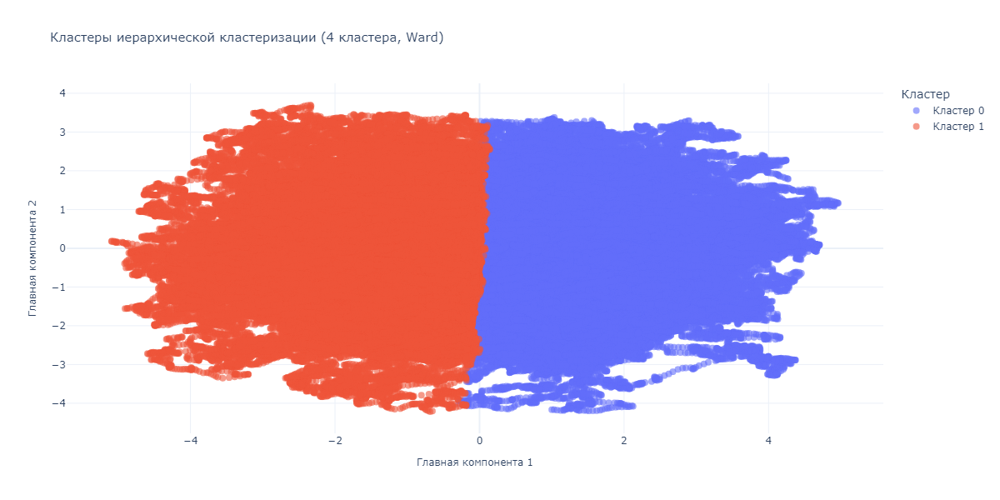

------------------------------------------------------------------------------------------------------------------------------------------------------
График количества кластеров K = 3


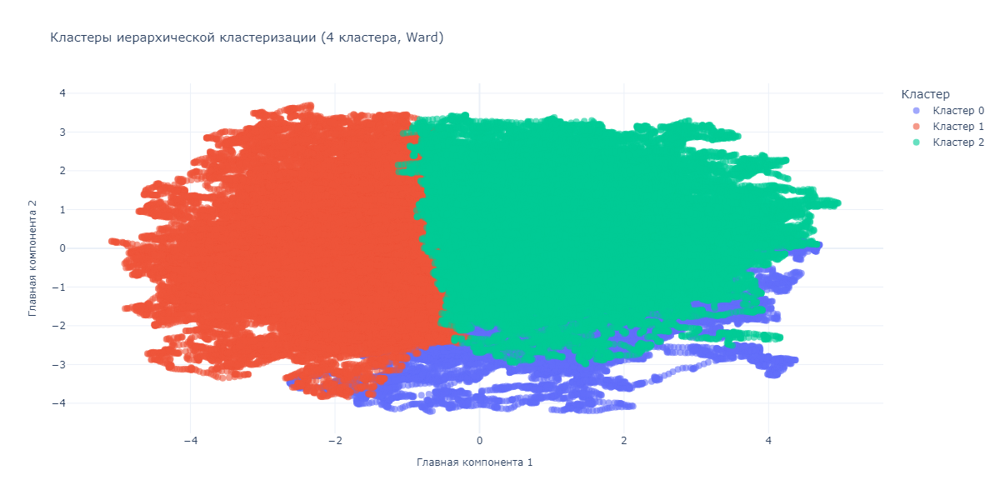

------------------------------------------------------------------------------------------------------------------------------------------------------
График количества кластеров K = 4


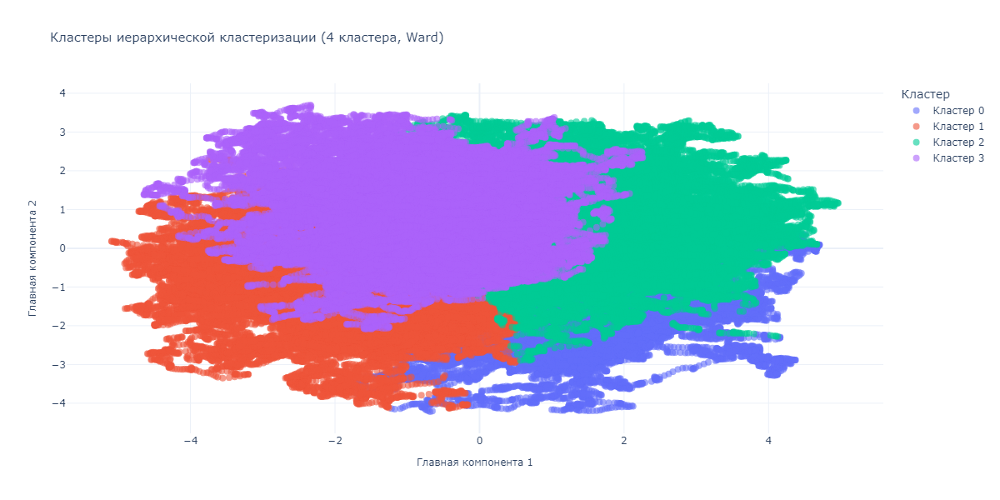

------------------------------------------------------------------------------------------------------------------------------------------------------
График количества кластеров K = 5


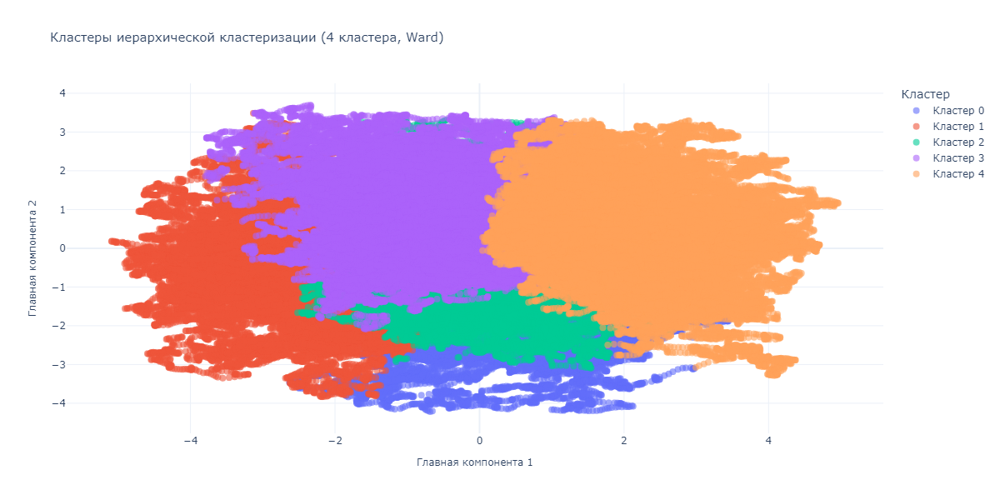

------------------------------------------------------------------------------------------------------------------------------------------------------
График количества кластеров K = 6


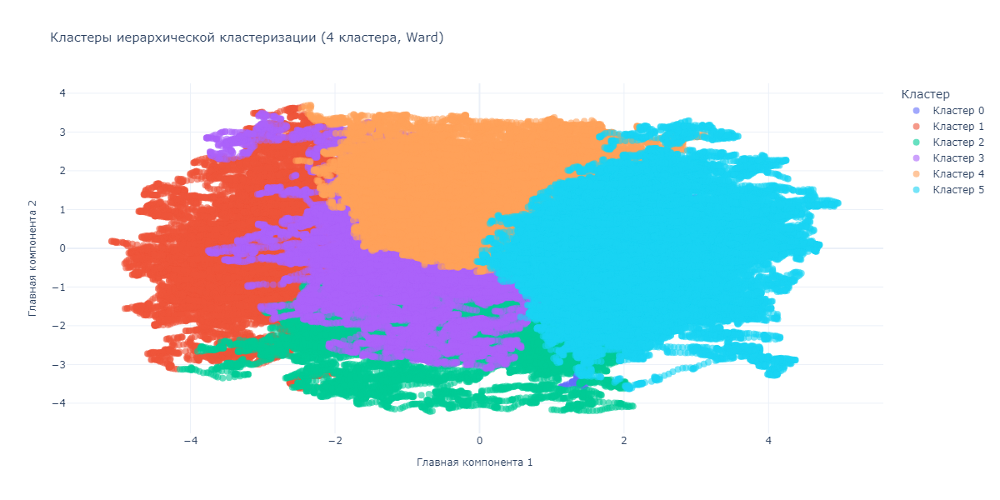

------------------------------------------------------------------------------------------------------------------------------------------------------


In [42]:
# Применяем K-Means и визуализируем для разных k
for k in [2, 3, 4, 5, 6]:
    
    
    # Создаём объект класса KMeans
    KM_model = cluster.KMeans(n_clusters = k, random_state = 42)
    KM_labels = KM_model.fit_predict(PAM_df_pca)

    # Снижаем размерность до 2D для визуализации
    pca_2d = decomposition.PCA(n_components = 2)
    features_2d = pca_2d.fit_transform(PAM_df_pca)
    df_2d = pd.DataFrame(features_2d, columns = ['PC1', 'PC2'])
    df_2d['cluster'] = KM_labels



    # Создаём DataFrame для визуализации
    pca_df = PAM_df_pca.iloc[:, :2].copy()  
    pca_df.columns = ['PC1', 'PC2']  
    pca_df['Cluster'] = KM_labels
    pca_df['Cluster'] = pca_df['Cluster'].astype(str)  
    
    
    
    # Создаём график
    print('-' * 150)
    print(f'График количества кластеров K = {k}')
    

    # Разделяем точки по кластерам
    traces = []
    unique_clusters = sorted(pca_df['Cluster'].unique())

    for clusters in unique_clusters:
        cluster_df = pca_df[pca_df['Cluster'] == clusters]
        trace = go.Scatter(
            x = cluster_df['PC1'],
            y = cluster_df['PC2'],
            mode = 'markers',
            name = f'Кластер {clusters}',
            
            marker = dict(
                size = 8,
                opacity = 0.6
            ),
            
            text = [f'Кластер: {clusters}' for _ in range(len(cluster_df))],
            hoverinfo = 'text+x+y'
        )
        
        # Добавляем точки кластера в список traces
        traces.append(trace)




    # Создаём фигуру
    fig = go.Figure(data = traces)

    fig.update_layout(
        title = 'Кластеры иерархической кластеризации (4 кластера, Ward)',
        xaxis_title = 'Главная компонента 1',
        yaxis_title = 'Главная компонента 2',
        width = 1200,
        height = 600,
        title_font_size = 15,
        xaxis_title_font_size = 12,
        yaxis_title_font_size = 12,
        legend_title_text = 'Кластер',
        showlegend = True,
        template = 'plotly_white'
    )

    fig.show('png')
    
    
print('-' * 150)

**Вывод:**

На основании построенных графиков видно, что данные плохо разбились на кластеры. Выберем 𝑘 = $4$.

Применим `K-Means` с 𝑘 = $4$ и визуализируем результаты:

In [44]:
# Применяем K-Means с k=2
KM_model = cluster.KMeans(
    n_clusters = 4,
    random_state = 42
)

KM_labels = KM_model.fit_predict(PAM_df_pca)   



# Снижаем размерность до 2D для визуализации
pca_2d = decomposition.PCA(n_components = 2)
features_2d = pca_2d.fit_transform(PAM_df_pca)
df_2d = pd.DataFrame(features_2d, columns = ['PC1', 'PC2'])
df_2d['cluster'] = KM_labels

Строим визуализацию:

------------------------------------------------------------------------------------------------------------------------------------------------------
График scatterplot для 4-х кластеров (PCA, k=4).


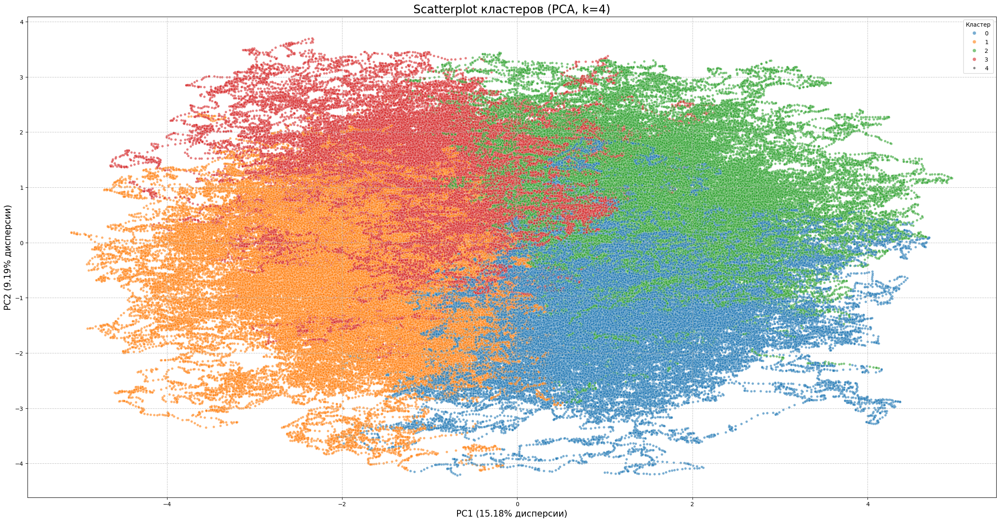

In [45]:
# Заголовок графика
print('-' * 150)
print('График scatterplot для 4-х кластеров (PCA, k=4).')



# Строим scatterplot
plt.figure(figsize = (30, 15))

sns.scatterplot(
    data = df_2d,
    x = 'PC1',
    y = 'PC2',
    hue = 'cluster',
    size = 4,
    palette = 'tab10',
    alpha = 0.6
)

plt.title('Scatterplot кластеров (PCA, k=4)', fontsize = 20)
plt.xlabel(f'PC1 ({pca_2d.explained_variance_ratio_[0]:.2%} дисперсии)', fontsize = 15)
plt.ylabel(f'PC2 ({pca_2d.explained_variance_ratio_[1]:.2%} дисперсии)', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.legend(title = 'Кластер')
plt.show()

#### $6.2$

#### **DBSCAN**

Теперь воспользуемся моделью `DBSCAN`, так как она отлично подходит для IMU-данных: Активности могут образовывать плотные кластеры (например, "ходьба" — это плотное скопление точек с похожими значениями ускорения).

Для начала, построим график для подбора оптимального значения параметра `eps` для алгоритма `DBSCAN`:

------------------------------------------------------------------------------------------------------------------------------------------------------
График подбора оптимального значения eps.


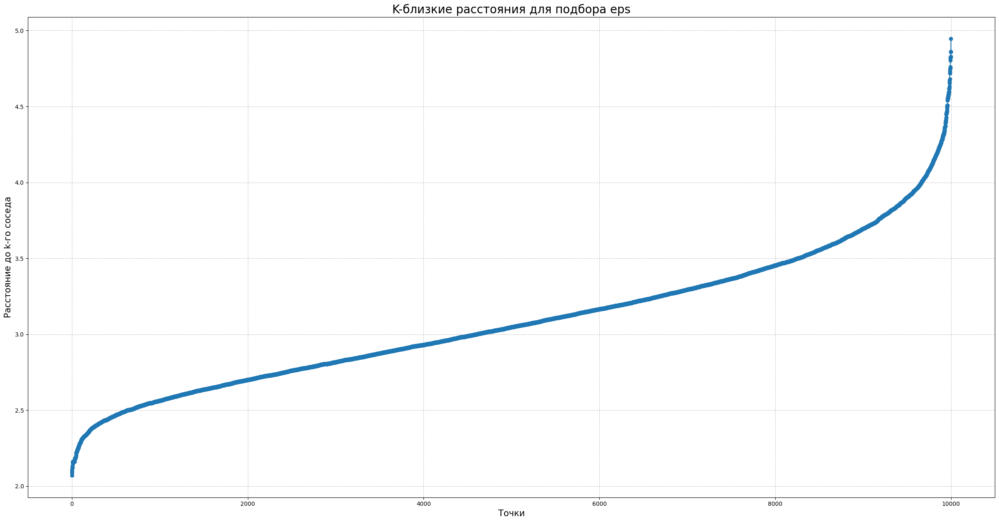

In [46]:
# Заголовок графика
print('-' * 150)
print('График подбора оптимального значения eps.')



# Создаём подвыборку из 10000 строк
# (для ускорения вычислений)
sample_size = 10000
np.random.seed(42)
sample_indices = np.random.choice(PAM_df_pca.shape[0], size = sample_size)
PAM_df_pca_sample = PAM_df_pca.iloc[sample_indices]  



# Вычисляем расстояния
k = 50    # min_samples
NN_method = neighbors.NearestNeighbors(n_neighbors = k, algorithm = 'auto')
NN_method.fit(PAM_df_pca_sample)
distances, indices = NN_method.kneighbors(PAM_df_pca_sample)
distances = np.sort(distances[:, k - 1])



# Строим график
plt.rcParams['figure.figsize'] = (30, 15) 

plt.plot(
    distances,
    marker = 'o',
    linestyle = '-'
)

plt.title('K-близкие расстояния для подбора eps', fontsize = 20)
plt.xlabel('Точки', fontsize = 15)
plt.ylabel('Расстояние до k-го соседа', fontsize = 15)
plt.grid(True, linestyle = '--', alpha = 0.7)
plt.show()

**Вывод:**

Оптимальное значение `eps` находится в диапазоне 8-10.

Чтобы точнее определить значение, посмотрим на значения расстояний в массиве `distances`:

In [47]:
# Смотрим значения вокруг "локтя"
print(f'Расстояния в районе 8000-й точки:\n\n{distances[7900: 9100]}')
print('-' * 70)

Расстояния в районе 8000-й точки:

[3.43727476 3.43738642 3.43751109 ... 3.72453051 3.72460829 3.72530591]
----------------------------------------------------------------------


Для начала создадим случайную выборку для того, чтобы ускорить работу следующих моделей:

In [48]:
# Создаём случайную выборку
sample_size = int(0.01 * len(PAM_df_pca))                                       # 1% от общего числа строк
indices = np.random.choice(PAM_df_pca.shape[0], sample_size, replace = False)   # случайная выборка
PAM_df_pca_sample = PAM_df_pca.iloc[indices]                                    # создаём выборку


# Проверяем размер выборки
print(f'Размер выборки: {PAM_df_pca_sample.shape}')
print('-' * 40)

Размер выборки: (5346, 14)
----------------------------------------


Переберём различные значения `eps`:

In [49]:
# Перебераем значения eps для DBSCAN
eps_values = [3, 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8, 3.9]



# Перебираем значения eps и вычисляем количество кластеров
for eps in eps_values:
    
    
    # Создаём объект класса DBSCAN
    DBSCAN_model = cluster.DBSCAN(
        eps = eps,
        min_samples = 5, 
        metric = 'euclidean',
        n_jobs = -1
    )
    
    # Обучаем модель DBSCAN
    DBSCAN_labels_sample = DBSCAN_model.fit_predict(PAM_df_pca_sample)
    
    
    # Вычисляем количество кластеров и шумовых точек
    n_clusters = len(set(DBSCAN_labels_sample)) - (1 if -1 in DBSCAN_labels_sample else 0)
    n_noise = list(DBSCAN_labels_sample).count(-1)
    print('-' * 50)
    print(f'eps = {eps}:')
    print(f'DBSCAN: {n_clusters} кластеров, {n_noise} шумовых точек ({n_noise / len(DBSCAN_labels_sample) * 100:.2f}%)')
    
    if n_clusters > 1:
        mask = DBSCAN_labels_sample != -1
        if sum(mask) > 0:
            sil_score = metrics.silhouette_score(PAM_df_pca_sample[mask], DBSCAN_labels_sample[mask])
            print(f'Silhouette Score: {sil_score:.4f}')
    else:
        print('Слишком мало кластеров для вычисления Silhouette Score.')

--------------------------------------------------
eps = 3:
DBSCAN: 21 кластеров, 23 шумовых точек (0.43%)
Silhouette Score: -0.0683
--------------------------------------------------
eps = 3.1:
DBSCAN: 12 кластеров, 20 шумовых точек (0.37%)
Silhouette Score: 0.0034
--------------------------------------------------
eps = 3.2:
DBSCAN: 8 кластеров, 18 шумовых точек (0.34%)
Silhouette Score: 0.0395
--------------------------------------------------
eps = 3.3:
DBSCAN: 5 кластеров, 16 шумовых точек (0.30%)
Silhouette Score: 0.1046
--------------------------------------------------
eps = 3.4:
DBSCAN: 4 кластеров, 8 шумовых точек (0.15%)
Silhouette Score: 0.1433
--------------------------------------------------
eps = 3.5:
DBSCAN: 3 кластеров, 6 шумовых точек (0.11%)
Silhouette Score: 0.1863
--------------------------------------------------
eps = 3.6:
DBSCAN: 2 кластеров, 3 шумовых точек (0.06%)
Silhouette Score: 0.2370
--------------------------------------------------
eps = 3.7:
DBSCAN: 2

Берём значение `eps` = $3.4$, который дал $4$ кластера.

Строим модель:

In [50]:
# Применяем DBSCAN
DBSCAN_model = cluster.DBSCAN(
    eps = 3.6, 
    min_samples = 5,
    metric = 'euclidean',
    n_jobs = -1
)

# Обучаем модель DBSCAN
DBSCAN_labels = DBSCAN_model.fit_predict(PAM_df_pca_sample)
    
    
# Анализируем результаты
# Количество кластеров и шумовых точек
n_clusters = len(set(DBSCAN_labels)) - (1 if -1 in DBSCAN_labels else 0)
n_noise = list(DBSCAN_labels).count(-1)
    
# Выводим информацию о количестве кластеров и шумовых точек
print(f'DBSCAN: {n_clusters} кластеров, {n_noise} шумовых точек ({n_noise / len(DBSCAN_labels) * 100:.2f}%)')
    
    
# Вычисляем Silhouette Score
if n_clusters > 1:
    mask = DBSCAN_labels != -1
    if sum(mask) > 0:
        sil_score = metrics.silhouette_score(PAM_df_pca_sample[mask], DBSCAN_labels[mask])
        print(f'Silhouette Score: {sil_score:.4f}')
else:
    print('Слишком мало кластеров для вычисления Silhouette Score.')

DBSCAN: 2 кластеров, 3 шумовых точек (0.06%)
Silhouette Score: 0.2370


Строим визуализацию:

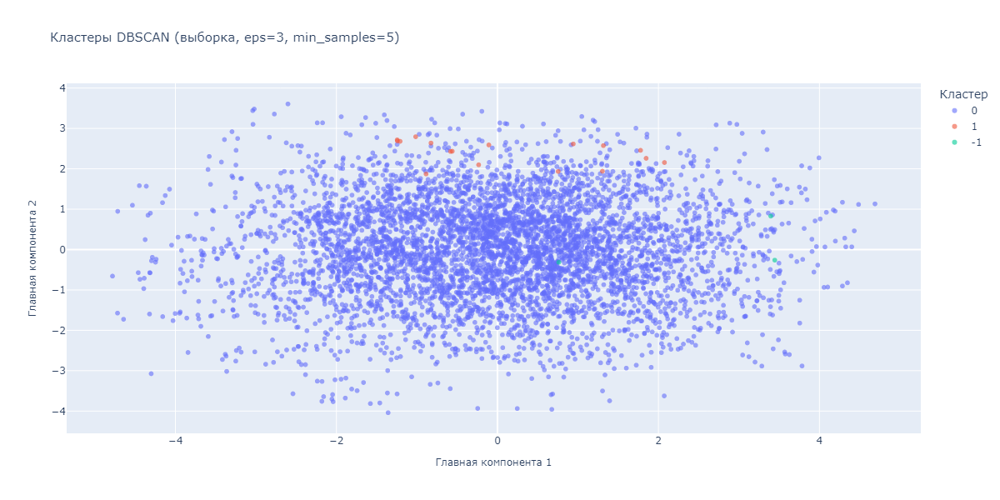

In [51]:
# Создаём DataFrame для визуализации
pca_df_sample = PAM_df_pca_sample.iloc[:, :2].copy()
pca_df_sample.columns = ['PC1', 'PC2']
pca_df_sample['Cluster'] = DBSCAN_labels
pca_df_sample['Cluster'] = pca_df_sample['Cluster'].astype(str)


# Создаём scatterplot
fig = px.scatter(
    pca_df_sample,
    x = 'PC1',
    y = 'PC2',
    color = 'Cluster',
    title = 'Кластеры DBSCAN (выборка, eps=3, min_samples=5)',
    
    labels = {
        'PC1': 'Главная компонента 1',
        'PC2': 'Главная компонента 2'
    },
    
    opacity = 0.6,
    size_max = 10
)


# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    legend_title_text = 'Кластер',
    showlegend = True
)


# Отображаем график
fig.show('png')

Строим гистограмму:

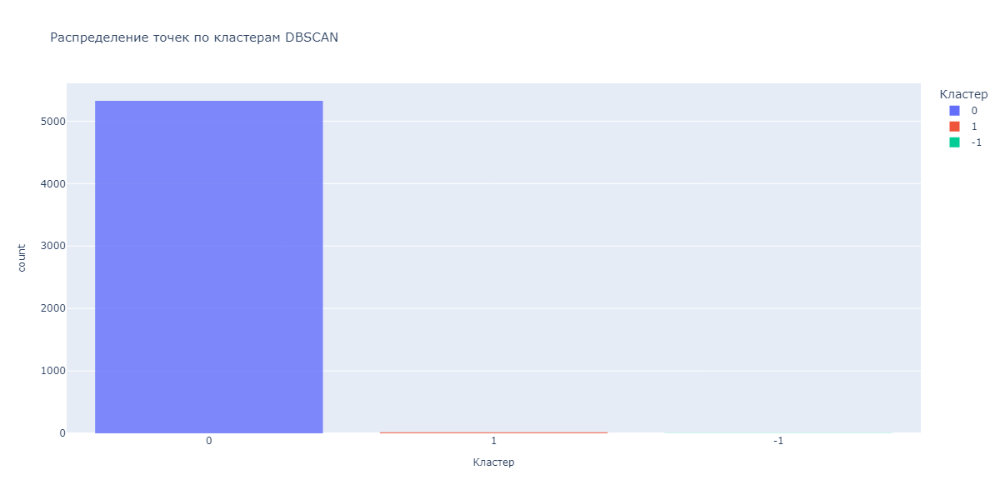

In [52]:
# Построение гистограммы распределения кластеров
fig = px.histogram(
    pca_df_sample,
    x = 'Cluster',
    title = 'Распределение точек по кластерам DBSCAN',
    
    labels = {
        'Cluster': 'Кластер',
        'count': 'Количество точек'
    },
    
    color = 'Cluster',
    opacity = 0.8
)


# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    showlegend = True
)


# Выводим график
fig.show('png')

#### $6.3$

#### **HDBSCAN**

Воспользуемся алгоритмом `HDBSCAN`, так как он автоматически определяет количество кластеров и хорошо работает с данными сложной структуры:

In [53]:
# Применяем HDBSCAN
HDBSCAN_model = cluster.HDBSCAN(
    min_cluster_size = 10, 
    min_samples = 5
)

# Обучаем модель и получаем метки кластеров
HDBSCAN_labels = HDBSCAN_model.fit_predict(PAM_df_pca_sample)



# Анализируем результаты
n_clusters = len(set(HDBSCAN_labels)) - (1 if -1 in HDBSCAN_labels else 0)
n_noise = list(HDBSCAN_labels).count(-1)

print(f'HDBSCAN: {n_clusters} кластеров, {n_noise} шумовых точек ({n_noise / len(HDBSCAN_labels) * 100:.2f}%)')



# Вычисляем Silhouette Score
if n_clusters > 1:
    mask = HDBSCAN_labels != -1
    
    if sum(mask) > 0:
        sil_score = metrics.silhouette_score(PAM_df_pca_sample[mask], HDBSCAN_labels[mask])
        
        print(f'Silhouette Score для HDBSCAN: {sil_score:.4f}')

HDBSCAN: 206 кластеров, 2309 шумовых точек (43.19%)
Silhouette Score для HDBSCAN: 0.3509


`HDBSCAN` выделил слишком много кластеров ($212$ кластеров), что указывает на то, что алгоритм слишком чувствителен к локальным плотностям.

Построим точечный график:

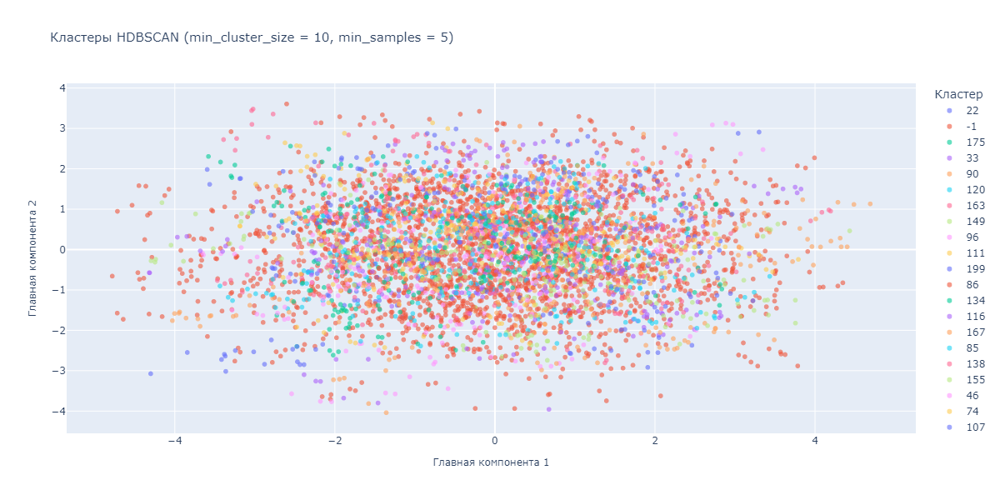

In [54]:
# Создаём DataFrame для визуализации
pca_df_sample = PAM_df_pca_sample.iloc[:, :2].copy()  
pca_df_sample.columns = ['PC1', 'PC2']  
pca_df_sample['Cluster'] = HDBSCAN_labels
pca_df_sample['Cluster'] = pca_df_sample['Cluster'].astype(str)  



# Построение графика
fig = px.scatter(
    pca_df_sample,
    x = 'PC1',
    y = 'PC2',
    color = 'Cluster',
    title = 'Кластеры HDBSCAN (min_cluster_size = 10, min_samples = 5)',
    
    labels = {
        'PC1': 'Главная компонента 1', 
        'PC2': 'Главная компонента 2'
    },
    
    opacity = 0.6,
    size_max = 10
)



# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    legend_title_text = 'Кластер',
    showlegend = True
)

# Выводим график
fig.show('png')

Построим гистограмму:

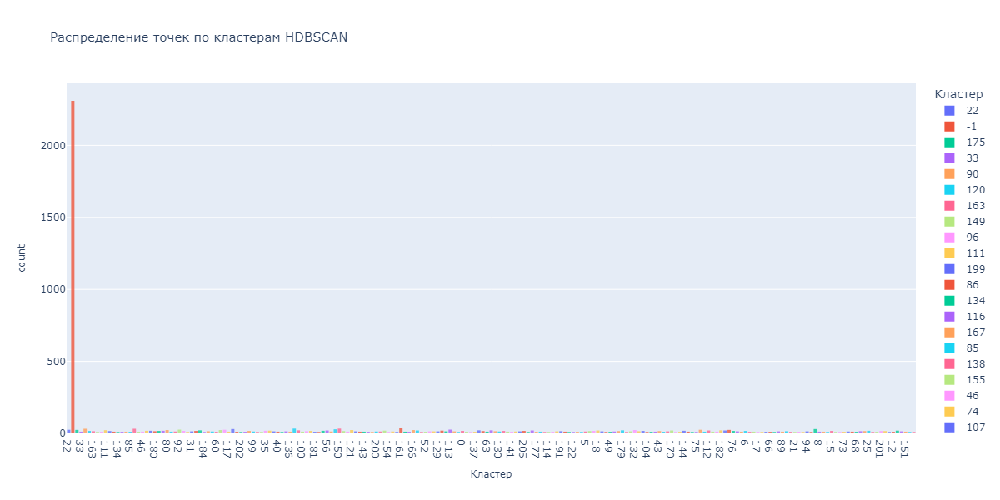

In [55]:
# Построение гистограммы распределения кластеров
fig = px.histogram(
    pca_df_sample,
    x = 'Cluster',
    title = 'Распределение точек по кластерам HDBSCAN',
    
    labels = {
        'Cluster': 'Кластер',
        'count': 'Количество точек'
    },
    
    color = 'Cluster',
    opacity = 0.8
)


# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    showlegend = True
)


# Выводим график
fig.show('png')

Поскольку модель создала слишком много кластеров, нужно объединить их в $4$. Для этого используем алгоритм `K-Means`:

In [56]:
# Исключаем шум
non_noise_mask = HDBSCAN_labels != -1
non_noise_data = PAM_df_pca_sample[non_noise_mask]
non_noise_labels = HDBSCAN_labels[non_noise_mask]



# Применяем K-Means для объединения
kmeans = cluster.KMeans(
    n_clusters = 4,
    random_state = 42,
    n_init = 10
)

# Обучаем модель K-Means и получаем новые метки кластеров
new_labels = kmeans.fit_predict(non_noise_data)



# Обновляем метки
labels_updated = HDBSCAN_labels.copy()
labels_updated[non_noise_mask] = new_labels



# Анализируем результаты
n_clusters = len(set(labels_updated)) - (1 if -1 in labels_updated else 0)
n_noise = list(labels_updated).count(-1)
print(f'После объединения: {n_clusters} кластеров, {n_noise} шумовых точек ({n_noise / len(labels_updated) * 100:.2f}%)')


# Silhouette Score
if n_clusters > 1:
    mask = labels_updated != -1
    if sum(mask) > 0:
        sil_score = metrics.silhouette_score(PAM_df_pca_sample[mask], labels_updated[mask])
        print(f'Silhouette Score после объединения: {sil_score:.4f}')

После объединения: 4 кластеров, 2309 шумовых точек (43.19%)
Silhouette Score после объединения: 0.0720


Теперь, используя параметры `HDBSCAN` и объединённые метки, примени их ко всем данным через классификатор `RandomForestClassifier`:

In [57]:
# Обучаем классификатор на выборке
RFC_model = ensemble.RandomForestClassifier(
    n_estimators = 100,
    random_state = 42
)

# Обучаем модель на подвыборке
RFC_model.fit(PAM_df_pca_sample, labels_updated)

# Предсказываем для всех данных
RFC_labels = RFC_model.predict(PAM_df_pca)



# Анализируем результаты
unique, counts = np.unique(RFC_labels, return_counts = True)
print("Распределение точек по кластерам:", dict(zip(unique, counts)))

Распределение точек по кластерам: {-1: 292239, 0: 51428, 1: 72516, 2: 46328, 3: 72090}


#### $6.4$

#### **Иерархическая кластеризация (Agglomerative Clustering)**

Используем иерархическую кластеризацию, так как она позволяет понять структуру данных и выбрать количество кластеров с помощью дендрограммы.

Строим дендрограмму:

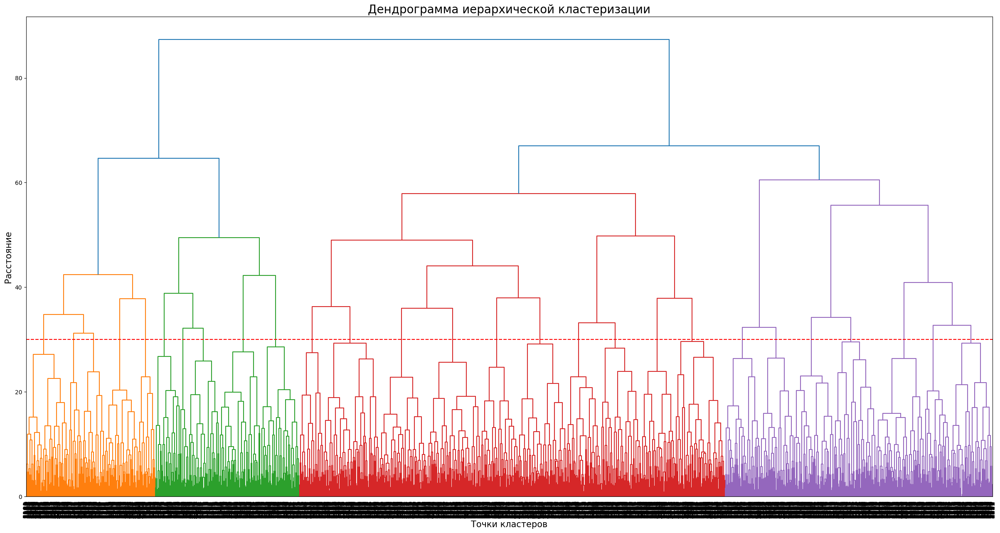

In [200]:
# Вычисляем иерархическую кластеризацию
# используем метод Уорда для минимизации дисперсии
Z = linkage(PAM_df_pca_sample, method = 'ward')



# Строим дендрограмму
plt.figure(figsize = (30, 15))

dendrogram(
    Z, 
    p = 20,
    leaf_rotation = 90, 
    leaf_font_size = 12,
    show_contracted = True
)

plt.title('Дендрограмма иерархической кластеризации', fontsize = 20)
plt.xlabel('Точки кластеров', fontsize = 15)
plt.ylabel('Расстояние', fontsize = 15)
plt.axhline(y = 30, color = 'r', linestyle = '--', label = 'Пороговое расстояние')
# plt.grid(True, linestyle = '--', alpha = 0.7)
plt.show()

Подберём оптимальное количество кластеров:

In [201]:
# Пробуем разное количество кластеров
for n_clusters in range(3, 7):
    
    # Создаём объект класса AgglomerativeClustering
    agg_clustering = cluster.AgglomerativeClustering(
        n_clusters = n_clusters, 
        linkage = 'ward', 
        metric = 'euclidean'
    )
    
    # Обучаем модель и получаем метки кластеров
    labels = agg_clustering.fit_predict(PAM_df_pca_sample)
    sil_score = metrics.silhouette_score(PAM_df_pca_sample, labels)
    print(f"Silhouette Score для {n_clusters} кластеров: {sil_score:.4f}")

Silhouette Score для 3 кластеров: 0.0281
Silhouette Score для 4 кластеров: 0.0277
Silhouette Score для 5 кластеров: 0.0211
Silhouette Score для 6 кластеров: 0.0226


Самым оптимальным значением является $4$.

Вычисляем иерархическую кластеризацию:

In [58]:
# Иерархическая кластеризация
agg_clustering = cluster.AgglomerativeClustering(
    n_clusters = 4, 
    linkage = 'ward', 
    metric = 'euclidean'
)

# Обучаем модель и получаем метки кластеров
Hierarchical_labels = agg_clustering.fit_predict(PAM_df_pca_sample)



# Подсчёт Silhouette Score
sil_score = metrics.silhouette_score(PAM_df_pca_sample, Hierarchical_labels)
print(f"Silhouette Score для иерархической кластеризации (4 кластера): {sil_score:.4f}")

# Проверяем количество точек в каждом кластере
unique, counts = np.unique(Hierarchical_labels, return_counts = True)
print("Распределение точек по кластерам:", dict(zip(unique, counts)))

Silhouette Score для иерархической кластеризации (4 кластера): 0.0222
Распределение точек по кластерам: {0: 1625, 1: 1497, 2: 1346, 3: 878}


Строим точечный график:

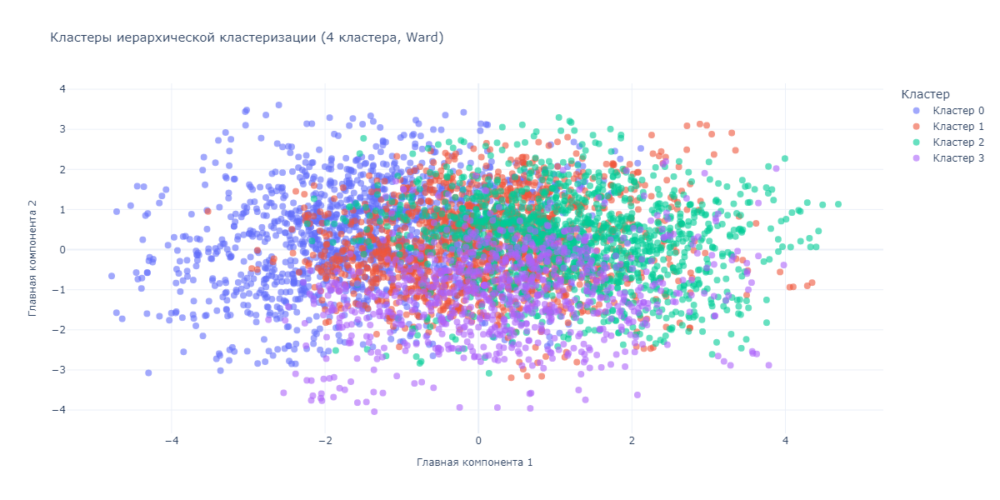

In [59]:
# Создаём DataFrame для визуализации
pca_df_sample = PAM_df_pca_sample.iloc[:, :2].copy()  
pca_df_sample.columns = ['PC1', 'PC2']  
pca_df_sample['Cluster'] = Hierarchical_labels
pca_df_sample['Cluster'] = pca_df_sample['Cluster'].astype(str)  



# Разделяем точки по кластерам
traces = []
unique_clusters = sorted(pca_df_sample['Cluster'].unique())

for cluster in unique_clusters:
    cluster_df = pca_df_sample[pca_df_sample['Cluster'] == cluster]
    trace = go.Scatter(
        x = cluster_df['PC1'],
        y = cluster_df['PC2'],
        mode = 'markers',
        name = f'Кластер {cluster}',
        
        marker = dict(
            size = 8,
            opacity = 0.6
        ),
        
        text = [f'Кластер: {cluster}' for _ in range(len(cluster_df))],
        hoverinfo = 'text+x+y'
    )
    
    # Добавляем точки кластера в список traces
    traces.append(trace)




# Создаём фигуру
fig = go.Figure(data = traces)

fig.update_layout(
    title = 'Кластеры иерархической кластеризации (4 кластера, Ward)',
    xaxis_title = 'Главная компонента 1',
    yaxis_title = 'Главная компонента 2',
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    legend_title_text = 'Кластер',
    showlegend = True,
    template = 'plotly_white'
)

fig.show('png')

Строим гистограмму:

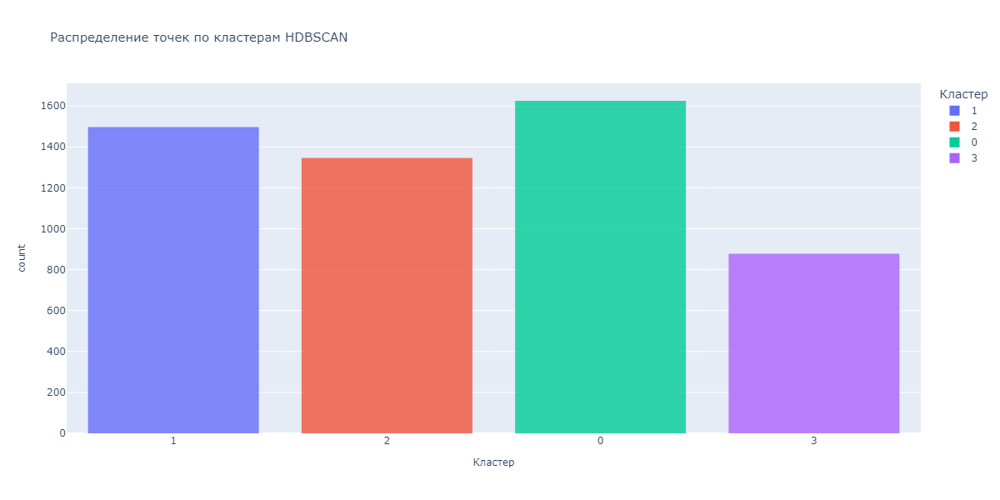

In [60]:
# Построение гистограммы распределения кластеров
fig = px.histogram(
    pca_df_sample,
    x = 'Cluster',
    title = 'Распределение точек по кластерам HDBSCAN',
    
    labels = {
        'Cluster': 'Кластер',
        'count': 'Количество точек'
    },
    
    color = 'Cluster',
    opacity = 0.8
)


# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    showlegend = True
)


# Выводим график
fig.show('png')

**Вывод:**

По построенному графику видно, что модель плохо разделила данные на кластеры.

#### $6.5$

#### **Gaussian Mixture Models (GMM)**

Используем `GMM`, так как он так же допускает кластеры разной формы.

Для начала попробуем разные типы ковариаций:

In [203]:
# Создаём список типов ковариации
cov_types = ['full', 'tied', 'diag', 'spherical']



# Перебираем разные типы ковариации
for cov_type in cov_types:
    
    # Создаём объект класса GaussianMixture
    GMM_model = mixture.GaussianMixture(
        n_components = 4, 
        covariance_type = cov_type, 
        random_state = 42
    )
    
    # Обучаем модель и получаем метки кластеров
    GMM_labels = GMM_model.fit_predict(PAM_df_pca_sample)
    
    # Рассчитываем silhouette score
    sil_score = metrics.silhouette_score(PAM_df_pca_sample, GMM_labels)
    
    # Выводим информацию о текущем типе ковариации
    print(f'Silhouette Score для GMM (covariance_type = "{cov_type}"): {sil_score:.4f}')

Silhouette Score для GMM (covariance_type = "full"): 0.0312
Silhouette Score для GMM (covariance_type = "tied"): 0.0452
Silhouette Score для GMM (covariance_type = "diag"): 0.0425
Silhouette Score для GMM (covariance_type = "spherical"): 0.0578


Наилучшее значение метрики Silhouette Score даёт ковариация `spherical`.

Строим модель:

In [61]:
# Применяем GMM
GMM_model = mixture.GaussianMixture(
    n_components = 4, 
    covariance_type = 'spherical', 
    random_state = 42
)

# Обучаем модель и получаем метки кластеров
GMM_labels = GMM_model.fit_predict(PAM_df_pca_sample)

# Подсчёт Silhouette Score
sil_score = metrics.silhouette_score(PAM_df_pca_sample, GMM_labels)
print(f"Silhouette Score для GMM (4 кластера, covariance_type = 'spherical'): {sil_score:.4f}")



# Проверяем количество точек в каждом кластере
unique, counts = np.unique(GMM_labels, return_counts = True)
print("Распределение точек по кластерам:", dict(zip(unique, counts)))

Silhouette Score для GMM (4 кластера, covariance_type = 'spherical'): 0.0508
Распределение точек по кластерам: {0: 729, 1: 1460, 2: 1329, 3: 1828}


Визуализируем кластеры в пространстве первых двух главных компонент (`PC1`, `PC2`):

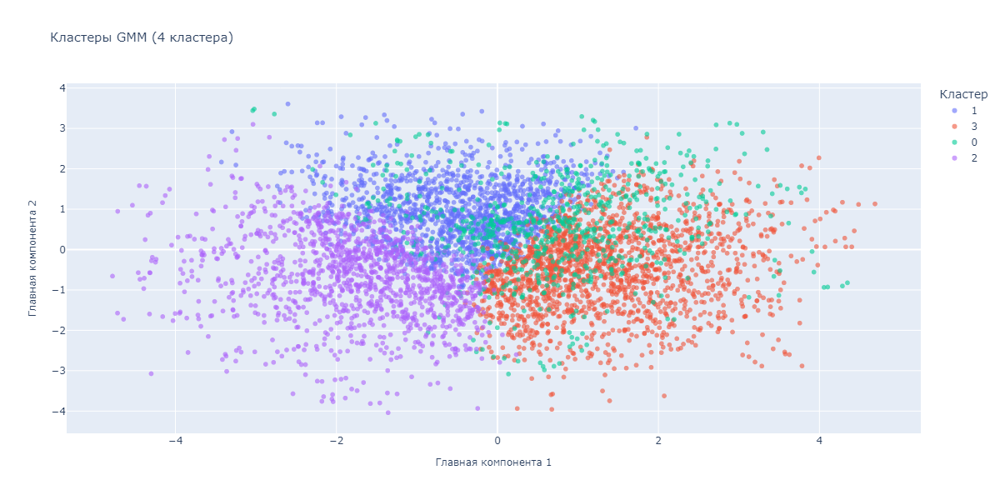

In [63]:
# Создаём DataFrame для визуализации
pca_df = PAM_df_pca_sample.iloc[:, :2].copy()
pca_df.columns = ['PC1', 'PC2']
pca_df['Cluster'] = GMM_labels
pca_df['Cluster'] = pca_df['Cluster'].astype(str)



# Построение графика
fig = px.scatter(
    pca_df,
    x = 'PC1',
    y = 'PC2',
    color = 'Cluster',
    title = 'Кластеры GMM (4 кластера)',
    
    labels = {
        'PC1': 'Главная компонента 1', 
        'PC2': 'Главная компонента 2'
    },
    
    opacity = 0.6,
    size_max = 10
)



# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    legend_title_text = 'Кластер',
    showlegend = True
)


# Выводим график
fig.show('png')

Визуализируем вероятность принадлежности к самому вероятному кластеру:

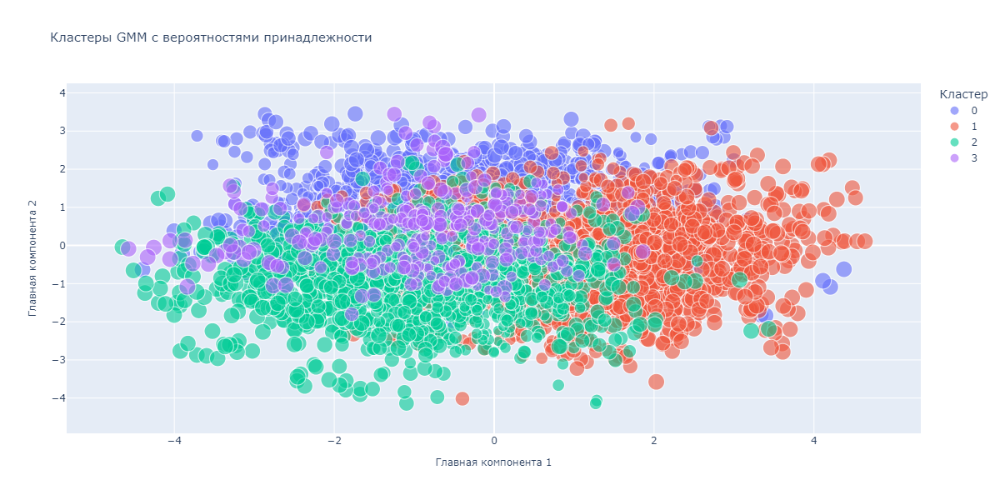

In [136]:
# Получаем вероятности
probs = GMM_model.predict_proba(PAM_df_pca_sample)
max_probs = np.max(probs, axis = 1) 



# Добавляем вероятности в DataFrame
pca_df_sample['Probability'] = max_probs



# Построение графика
fig = px.scatter(
    pca_df_sample,
    x = 'PC1',
    y = 'PC2',
    color = 'Cluster',
    size = 'Probability',
    title = 'Кластеры GMM с вероятностями принадлежности',
    
    labels = {
        'PC1': 'Главная компонента 1',
        'PC2': 'Главная компонента 2'
    },
    
    opacity = 0.6
)



# Настройка оформления
fig.update_layout(
    width = 1200,
    height = 600,
    title_font_size = 15,
    xaxis_title_font_size = 12,
    yaxis_title_font_size = 12,
    legend_title_text = 'Кластер',
    showlegend = True
)


# Выводим график
fig.show('png')

#### $6.6$

#### **Сохраняем лучшую модель.**

Проанализируем кластеры модели `KMeans`:

In [64]:
# Создаём копию DataFrame для KMeans
KM_data = PAM_df_pca.copy()
KM_data['cluster'] = KM_labels

# Анализируем кластеры
cluster_means = KM_data.groupby('cluster').mean()
print(cluster_means)

              PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
cluster                                                                         
0        1.007414 -0.938446 -0.703920 -0.028993  0.169842 -0.157010 -0.060181   
1       -1.576799 -0.534789  0.394389  0.435599  0.145211  0.042513  0.076605   
2        1.210666  0.625583  0.685683  0.243994  0.004545  0.112034 -0.020827   
3       -0.768198  0.836790 -0.456675 -0.705841 -0.336207 -0.007496  0.005961   

              PC8       PC9      PC10      PC11      PC12      PC13      PC14  
cluster                                                                        
0       -0.071606 -0.030891 -0.012393 -0.021946  0.000769 -0.030783 -0.007320  
1        0.160119 -0.101278  0.049718 -0.057483 -0.010174  0.018599  0.022861  
2        0.126620 -0.036175 -0.011774  0.040017 -0.032704 -0.026076 -0.015998  
3       -0.237522  0.180205 -0.026053  0.038153  0.047054  0.042260  0.001738  


Проанализируем кластеры модели `DBSCAN`:

In [65]:
DBSCAN_data = PAM_df_pca_sample.copy()
DBSCAN_data['cluster'] = DBSCAN_labels

# Анализируем кластеры
HDBSCAN_cluster = DBSCAN_data.groupby('cluster').mean()
print(HDBSCAN_cluster)

              PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
cluster                                                                         
-1       2.534246  0.083981  0.656960 -1.365534 -1.598671 -1.235491  0.327886   
 0      -0.013146 -0.005609  0.000896  0.012461  0.009160  0.003795  0.005563   
 1       0.123925  2.405205 -1.260691 -3.407910 -2.129435  1.562732  0.649408   

              PC8       PC9      PC10      PC11      PC12      PC13      PC14  
cluster                                                                        
-1      -1.011968 -0.039850  0.905954 -0.649490 -0.129236 -1.446926 -0.878666  
 0      -0.023106  0.015633  0.011231  0.007276 -0.013153 -0.006361  0.027845  
 1      -0.932602 -1.354447  0.081388 -2.029128 -0.556133  0.712566  0.868970  


Проанализируем кластеры модели `HDBSCAN`:

In [66]:
HDBSCAN_data = PAM_df_pca.copy()
HDBSCAN_data['cluster'] = RFC_labels

# Анализируем кластеры
HDBSCAN_cluster = HDBSCAN_data.groupby('cluster').mean()
print(HDBSCAN_cluster)

              PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
cluster                                                                         
-1      -0.033211  0.071390 -0.018084  0.065079  0.019667 -0.055125  0.030044   
 0      -1.407921  0.633128 -0.883223 -0.227826 -0.185369  0.368065  0.097839   
 1       1.431969 -0.817546 -0.280073  0.078092 -0.300430  0.246275  0.078067   
 2      -1.258835 -1.100744  0.769370  0.227503  0.157911  0.206427 -0.221861   
 3       0.507572  0.788693  0.490690 -0.326045  0.253238 -0.419496 -0.127542   

              PC8       PC9      PC10      PC11      PC12      PC13      PC14  
cluster                                                                        
-1       0.027096  0.001598 -0.032350 -0.014604  0.028598  0.047426 -0.032485  
 0      -0.194869 -0.031411  0.111773  0.012118  0.169806 -0.056124  0.127409  
 1      -0.049026 -0.043292  0.002290 -0.261301 -0.113357 -0.087888  0.154900  
 2       0.162409  0.167858  0.0

Проанализируем кластеры модели `Hierarchical agglomerative`:

In [67]:
# Создаём копию DataFrame для Hierarchical_labels
Hierarchical_data = PAM_df_pca_sample.copy()
Hierarchical_data['cluster'] = Hierarchical_labels


# Анализируем кластеры
cluster_hierarchical = Hierarchical_data.groupby('cluster').mean()
print(cluster_hierarchical)

              PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
cluster                                                                         
0       -1.360073  0.308612 -0.157812 -0.157090 -0.306206  0.012840 -0.051855   
1        0.114318  0.113731  0.095086 -0.039049  0.708440  0.083624  0.238193   
2        1.223632  0.219512 -0.063283 -0.145040 -0.282210  0.185366  0.015844   
3        0.377759 -1.088776  0.210238  0.584609 -0.199667 -0.401460 -0.286998   

              PC8       PC9      PC10      PC11      PC12      PC13      PC14  
cluster                                                                        
0       -0.056205  0.151808  0.131022  0.111465 -0.026690 -0.018647  0.054407  
1       -0.108180 -0.222965  0.016988  0.028145 -0.005544 -0.136078 -0.045418  
2        0.306034  0.140073 -0.154300 -0.197355  0.038424  0.174827  0.109116  
3       -0.342366 -0.047072  0.037885  0.050891 -0.091053 -0.031224 -0.007801  


Проанализируем кластеры модели `GMM`:

In [68]:
# Создаём копию DataFrame для GMM
GMM_data = PAM_df_pca_sample.copy()
GMM_data['cluster'] = GMM_labels


# Анализируем кластеры
cluster_means = GMM_data.groupby('cluster').mean()
print(cluster_means)

              PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
cluster                                                                         
0        0.750837  0.592916  0.394645 -1.232470 -0.437111 -0.491906  0.077508   
1       -0.491110  0.965859 -0.001631  0.252431  0.240108  0.065023  0.073812   
2       -1.776821 -0.692957  0.006533  0.006849 -0.042513  0.069097 -0.029910   
3        1.351614 -0.497912 -0.168866  0.287283  0.017715  0.117564 -0.045331   

              PC8       PC9      PC10      PC11      PC12      PC13      PC14  
cluster                                                                        
0       -0.234276 -0.316435  0.073510  0.086738 -0.107026  0.078494 -0.108978  
1        0.013785  0.149988 -0.032984  0.029963  0.053878 -0.112372  0.028480  
2       -0.030688 -0.035708  0.097074  0.017483 -0.030245  0.064811  0.085854  
3        0.027074  0.065248 -0.038581 -0.069971 -0.022068 -0.002954  0.046064  


Сохраняем модель:

In [74]:
# Сопоставление
mapping = {-1: 1, 0: 1, 1: 2, 2: 3, 3: 4}
HDBSCAN_data['activityID'] = HDBSCAN_data['cluster'].map(mapping)



# Создаём файл
submission = pd.DataFrame({
    'Index': range(0, len(HDBSCAN_data)),
    'activityID': HDBSCAN_data['activityID']
})

# Сохраняем в CSV файл
submission.to_csv('submission.csv', index = False)

## <CENTER> **`7.` Вывод**

Таким образом, среди всех рассмотренных моделей, лучше всего на кластеры разбила модель `Gaussian Mixture Models (GMM)`.